# Cannabis Recommendation System


## Overview

As of October of 2020, 33 states have legalized the use of medicinal cannabis, including 11 states that have also legalized its recreational use for adults the age of 21 and over. The legal cannabis industry is very young and in constant growth and expansion and it is only a matter of time until it becomes legal on a Federal level. There are countless dispensaries that sell cannabis products through websites like Weedmaps and Leafly, you simply choose a dispensary and check out their menu and make an order, which you can then either pick up or have delivered. The website also has a section which is dedicated to the many strains of the cannabis plant to rate, report on the effects, and describe the flavors associated with the strain that the user has tried. This section is usually curated by experts in the field with the use of their experience and knowledge about marijuana. 

We see recommendation systems in our everyday life more and more, Netflix, Amazon, and Instagram are just a few examples of where this technology is used to give the user an easier way to connect to people and make decisions about what to buy or watch next.


## Objective

Using the Cannabis Strains dataset found at (https://www.kaggle.com/kingburrito666/cannabis-strains), I will first explore the data focusing on the types of strains, effects, and flavors that are available to everyone, in order to gain some insight about what is important when it comes to choosing what to try out. Since there is no user-based data I will then proceed to build a content-based recommendation system which will take the input of a certain strain and return the 10 most similar strains to the user, this will be achieved using the Cosine Similarity distance metric. 





## Obtaining the Data

In [1]:
# Importing necessary packages
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

In [2]:
# Reading csv file
raw_df = pd.read_csv("cannabis.csv")
raw_df.head()

,Strain,Type,Rating,Effects,Flavor,Description
0,100-Og,hybrid,4.0,"Creative,Energetic,Tingly,Euphoric,Relaxed","Earthy,Sweet,Citrus",$100 OG is a 50/50 hybrid strain that packs a ...
1,98-White-Widow,hybrid,4.7,"Relaxed,Aroused,Creative,Happy,Energetic","Flowery,Violet,Diesel",The ‘98 Aloha White Widow is an especially pot...
2,1024,sativa,4.4,"Uplifted,Happy,Relaxed,Energetic,Creative","Spicy/Herbal,Sage,Woody",1024 is a sativa-dominant hybrid bred in Spain...
3,13-Dawgs,hybrid,4.2,"Tingly,Creative,Hungry,Relaxed,Uplifted","Apricot,Citrus,Grapefruit",13 Dawgs is a hybrid of G13 and Chemdawg genet...
4,24K-Gold,hybrid,4.6,"Happy,Relaxed,Euphoric,Uplifted,Talkative","Citrus,Earthy,Orange","Also known as Kosher Tangie, 24k Gold is a 60%..."


In [3]:
# Setting to be able to see all rows
pd.set_option("max_rows", None)
pd.set_option("max_columns", None)

In [4]:
# Checking the number of strains
len(raw_df["Strain"])

2351

In [5]:
# Quick look at the data
raw_df.describe()

,Rating
count,2351.000000
mean,4.310634
std,0.836394
min,0.000000
25%,4.200000
50%,4.400000
75%,4.700000
max,5.000000


From the statistics we see above, we can tell the the average rating for the strain is very high at 4.31, this means that cannabis users seem to be very easily satisfied.

## Scrub the Data

In [6]:
# Checking for null values
raw_df.isnull().sum()

Strain          0
Type            0
Rating          0
Effects         0
Flavor         46
Description    33
dtype: int64

Since this project will be focused on the type of strain, effects, and flavors I will drop the description column for now and use it in my future work.

In [7]:
# Dropping Description column
raw_df.drop(columns="Description", inplace = True)
raw_df.isnull().sum()

Strain      0
Type        0
Rating      0
Effects     0
Flavor     46
dtype: int64

In [8]:
# Fill in null values with "None"
raw_df["Flavor"].fillna("None", inplace = True)
raw_df.isnull().sum()

Strain     0
Type       0
Rating     0
Effects    0
Flavor     0
dtype: int64

In [9]:
# Drop the strains that don't have an effect reported
none_reported = raw_df[raw_df["Effects"] == "None"]
raw_df.drop(index= none_reported.index, inplace= True)
print(raw_df.shape)
raw_df

(2264, 5)


,Strain,Type,Rating,Effects,Flavor
0,100-Og,hybrid,4.0,"Creative,Energetic,Tingly,Euphoric,Relaxed","Earthy,Sweet,Citrus"
1,98-White-Widow,hybrid,4.7,"Relaxed,Aroused,Creative,Happy,Energetic","Flowery,Violet,Diesel"
2,1024,sativa,4.4,"Uplifted,Happy,Relaxed,Energetic,Creative","Spicy/Herbal,Sage,Woody"
3,13-Dawgs,hybrid,4.2,"Tingly,Creative,Hungry,Relaxed,Uplifted","Apricot,Citrus,Grapefruit"
4,24K-Gold,hybrid,4.6,"Happy,Relaxed,Euphoric,Uplifted,Talkative","Citrus,Earthy,Orange"
6,3-Kings,hybrid,4.4,"Relaxed,Euphoric,Happy,Uplifted,Hungry","Earthy,Sweet,Pungent"
7,303-Og,indica,4.2,"Relaxed,Happy,Euphoric,Uplifted,Giggly","Citrus,Pungent,Earthy"
8,3D-Cbd,sativa,4.6,"Uplifted,Focused,Happy,Talkative,Relaxed","Earthy,Woody,Flowery"
9,3X-Crazy,indica,4.4,"Relaxed,Tingly,Happy,Euphoric,Uplifted","Earthy,Grape,Sweet"
10,3Rd-Coast-Panama-Chunk,hybrid,4.7,"Energetic,Happy,Talkative,Uplifted","Pine,Diesel"


In [10]:
# resetting index after drop
raw_df.reset_index(inplace= True, drop= True)
raw_df

,Strain,Type,Rating,Effects,Flavor
0,100-Og,hybrid,4.0,"Creative,Energetic,Tingly,Euphoric,Relaxed","Earthy,Sweet,Citrus"
1,98-White-Widow,hybrid,4.7,"Relaxed,Aroused,Creative,Happy,Energetic","Flowery,Violet,Diesel"
2,1024,sativa,4.4,"Uplifted,Happy,Relaxed,Energetic,Creative","Spicy/Herbal,Sage,Woody"
3,13-Dawgs,hybrid,4.2,"Tingly,Creative,Hungry,Relaxed,Uplifted","Apricot,Citrus,Grapefruit"
4,24K-Gold,hybrid,4.6,"Happy,Relaxed,Euphoric,Uplifted,Talkative","Citrus,Earthy,Orange"
5,3-Kings,hybrid,4.4,"Relaxed,Euphoric,Happy,Uplifted,Hungry","Earthy,Sweet,Pungent"
6,303-Og,indica,4.2,"Relaxed,Happy,Euphoric,Uplifted,Giggly","Citrus,Pungent,Earthy"
7,3D-Cbd,sativa,4.6,"Uplifted,Focused,Happy,Talkative,Relaxed","Earthy,Woody,Flowery"
8,3X-Crazy,indica,4.4,"Relaxed,Tingly,Happy,Euphoric,Uplifted","Earthy,Grape,Sweet"
9,3Rd-Coast-Panama-Chunk,hybrid,4.7,"Energetic,Happy,Talkative,Uplifted","Pine,Diesel"


In [11]:
# Dropping any duplicated Strains
raw_df.drop_duplicates(inplace = True)

In [12]:
raw_df.shape

(2263, 5)

In [13]:
# Making a copy of the raw data for manipulation ahead
df_copy = raw_df.copy()
df_copy.head()

,Strain,Type,Rating,Effects,Flavor
0,100-Og,hybrid,4.0,"Creative,Energetic,Tingly,Euphoric,Relaxed","Earthy,Sweet,Citrus"
1,98-White-Widow,hybrid,4.7,"Relaxed,Aroused,Creative,Happy,Energetic","Flowery,Violet,Diesel"
2,1024,sativa,4.4,"Uplifted,Happy,Relaxed,Energetic,Creative","Spicy/Herbal,Sage,Woody"
3,13-Dawgs,hybrid,4.2,"Tingly,Creative,Hungry,Relaxed,Uplifted","Apricot,Citrus,Grapefruit"
4,24K-Gold,hybrid,4.6,"Happy,Relaxed,Euphoric,Uplifted,Talkative","Citrus,Earthy,Orange"


## Explore the Data

Now we will begin to look through our data and see what is important when it comes to the different strains we can choose from. 

There are three types of Cannabis strains:

 - Indicas: this strain usually produces calming effects that can be felt through your whole body
 - Sativas: this strain gives more of a "head-high" and can often produce energizing and creative effects
 - Hybrids: this is the best of both worlds but can either be indica or sativa dominant
 
We will now see how these types are distributed in our data. 

In [14]:
strain_type = list(["hybrid", "indica", "sativa"])
type_values = raw_df["Type"].value_counts()

In [15]:
type_values

hybrid    1162
indica     680
sativa     421
Name: Type, dtype: int64

In [16]:
strain_type

['hybrid', 'indica', 'sativa']

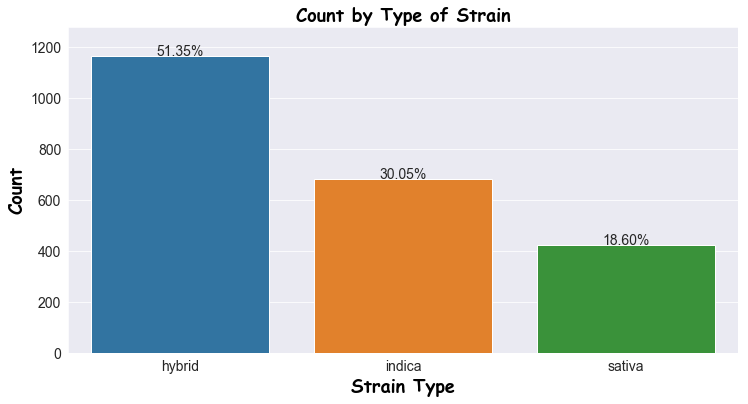

In [17]:
font = {"family" : "fantasy", "color" : "black",
       "weight" : "bold", "size" : 18}

plt.figure(figsize = (12, 6))
sns.set_style("darkgrid")
ax = sns.barplot(x = strain_type, y = type_values)
plt.xlabel(xlabel = "Strain Type", fontdict=font)
plt.ylabel(ylabel = "Count", fontdict=font)
plt.title(label = "Count by Type of Strain", fontdict=font)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
sizes = []
total = len(raw_df)
for p in ax.patches:
    height = p.get_height()
    sizes.append(height)
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2f}%'.format(height/total*100),
            ha="center", fontsize=14) 
ax.set_ylim(0, max(sizes) * 1.10)

plt.show();


As shown in the plot above we can see that the distribution of the hybrid type strain is the highest, followed by indicas and then sativas. Hybrids are a mix of the indica and sativa types, which is probably more appealing to customers since they can get the effects they like from one type without the effects they might not like from the other. 

Let's take a look and try to learn how effects and flavors can be related to each of the type of strains that we have.
I will extract the effects and flavors from their current columns and separate them for visualization.

In [18]:
# Function to extract the effects from the current column
def split_effs(df):
    
    """This function takes a dataframe as an input and 
    will extract the effects that are separated by a comma, 
    place them in a dictionary and count the times they appear."""
    
    eff_dict = {}
    for eff_list in df["Effects"]:
        effects_list = eff_list.split(",")
        for effect in effects_list:
            if not effect in eff_dict:
                eff_dict[effect] = 1
            else:
                eff_dict[effect] += 1
    
    return eff_dict

# Function to extract the flavors
def split_flavors(df):
    
    flav_dict = {}
    for flav_list in df["Flavor"]:
        flavs_list = flav_list.split(",")
        for flavor in flavs_list:
            if not flavor in flav_dict:
                flav_dict[flavor] = 1
            else:
                flav_dict[flavor] += 1
    
    return flav_dict

In [19]:
# Subsetting by type of strain
indicas_set = df_copy[df_copy["Type"] == "indica"]
sativas_set = df_copy[df_copy["Type"] == "sativa"]
hybrids_set = df_copy[df_copy["Type"]== "hybrid"]

In [20]:
# sanity check
hybrids_set.head()

,Strain,Type,Rating,Effects,Flavor
0,100-Og,hybrid,4.0,"Creative,Energetic,Tingly,Euphoric,Relaxed","Earthy,Sweet,Citrus"
1,98-White-Widow,hybrid,4.7,"Relaxed,Aroused,Creative,Happy,Energetic","Flowery,Violet,Diesel"
3,13-Dawgs,hybrid,4.2,"Tingly,Creative,Hungry,Relaxed,Uplifted","Apricot,Citrus,Grapefruit"
4,24K-Gold,hybrid,4.6,"Happy,Relaxed,Euphoric,Uplifted,Talkative","Citrus,Earthy,Orange"
5,3-Kings,hybrid,4.4,"Relaxed,Euphoric,Happy,Uplifted,Hungry","Earthy,Sweet,Pungent"


In [21]:
ind_effs = split_effs(indicas_set)
ind_effs

{'Relaxed': 628,
 'Happy': 562,
 'Euphoric': 516,
 'Uplifted': 331,
 'Giggly': 94,
 'Tingly': 143,
 'Focused': 106,
 'Aroused': 69,
 'Creative': 128,
 'Sleepy': 468,
 'Hungry': 210,
 'Talkative': 58,
 'Energetic': 36}

In [22]:
sat_effs = split_effs(sativas_set)
sat_effs

{'Uplifted': 328,
 'Happy': 342,
 'Relaxed': 202,
 'Energetic': 268,
 'Creative': 190,
 'Focused': 180,
 'Talkative': 110,
 'Euphoric': 276,
 'Giggly': 36,
 'Hungry': 41,
 'Aroused': 43,
 'Tingly': 40,
 'Sleepy': 29}

In [23]:
hy_effs = split_effs(hybrids_set)
hy_effs

{'Creative': 429,
 'Energetic': 342,
 'Tingly': 163,
 'Euphoric': 842,
 'Relaxed': 895,
 'Aroused': 87,
 'Happy': 966,
 'Hungry': 227,
 'Uplifted': 848,
 'Talkative': 192,
 'Sleepy': 240,
 'Focused': 309,
 'Giggly': 168,
 'Dry': 1,
 'Mouth': 1}

In [24]:
# Extracting flavors
sat_flav = split_flavors(sativas_set)
sat_flav

{'Spicy/Herbal': 50,
 'Sage': 8,
 'Woody': 44,
 'Earthy': 178,
 'Flowery': 38,
 'Sweet': 207,
 'Pungent': 62,
 'Mango': 12,
 'Lemon': 46,
 'None': 12,
 'Vanilla': 5,
 'Pepper': 8,
 'Pine': 49,
 'Mint': 3,
 'Berry': 44,
 'Blueberry': 12,
 'Diesel': 41,
 'Citrus': 143,
 'Tropical': 57,
 'Skunk': 26,
 'Grape': 10,
 'Strawberry': 15,
 'Minty': 8,
 'Grapefruit': 10,
 'Tree': 12,
 'Fruit': 12,
 'Cheese': 6,
 'Menthol': 5,
 'Lime': 16,
 'Tar': 2,
 'Chemical': 5,
 'Nutty': 5,
 'Coffee': 6,
 'Blue': 1,
 'Ammonia': 6,
 'Honey': 3,
 'Orange': 23,
 'Lavender': 4,
 'Pineapple': 18,
 'Tea': 4,
 'Apricot': 5,
 'Tobacco': 1,
 'Apple': 2,
 'Violet': 1,
 'Plum': 1,
 'Rose': 2}

In [25]:
ind_flav = split_flavors(indicas_set)
ind_flav

{'Citrus': 83,
 'Pungent': 157,
 'Earthy': 378,
 'Grape': 69,
 'Sweet': 312,
 'Woody': 104,
 'Pine': 94,
 'Diesel': 51,
 'Flowery': 94,
 'Berry': 145,
 'Spicy/Herbal': 69,
 'Lemon': 31,
 'Peach': 1,
 'Nutty': 11,
 'Chestnut': 5,
 'Skunk': 49,
 'Chemical': 10,
 'Tobacco': 3,
 'Sage': 10,
 'Grapefruit': 8,
 'None': 21,
 'Honey': 10,
 'Lime': 13,
 'Cheese': 24,
 'Mint': 6,
 'Coffee': 9,
 'Apple': 3,
 'Ammonia': 11,
 'Tropical': 26,
 'Tree': 12,
 'Fruit': 12,
 'Mango': 6,
 'Blueberry': 48,
 'Orange': 8,
 'Pepper': 18,
 'Vanilla': 7,
 'Blue': 4,
 'Pineapple': 4,
 'Tar': 1,
 'Rose': 9,
 'Butter': 12,
 'Menthol': 8,
 'Lavender': 13,
 'Tea': 3,
 'Plum': 1,
 'Minty': 11,
 'Strawberry': 7,
 'Apricot': 1,
 'Violet': 1,
 'Pear': 1}

In [26]:
hy_flav = split_flavors(hybrids_set)
hy_flav

{'Earthy': 548,
 'Sweet': 532,
 'Citrus': 299,
 'Flowery': 134,
 'Violet': 5,
 'Diesel': 148,
 'Apricot': 3,
 'Grapefruit': 20,
 'Orange': 46,
 'Pungent': 232,
 'Pine': 157,
 'Skunk': 99,
 'Woody': 107,
 'Pepper': 32,
 'Menthol': 10,
 'Blue': 4,
 'Cheese': 38,
 'Chemical': 22,
 'Lemon': 112,
 'Tea': 10,
 'Spicy/Herbal': 106,
 'Tropical': 70,
 'None': 40,
 'Strawberry': 25,
 'Grape': 47,
 'Mango': 14,
 'Blueberry': 85,
 'Nutty': 9,
 'Apple': 11,
 'Berry': 166,
 'Chestnut': 2,
 'Lavender': 20,
 'Ammonia': 11,
 'Sage': 21,
 'Minty': 22,
 'Mint': 9,
 'Tree': 10,
 'Fruit': 10,
 'Vanilla': 22,
 'Lime': 24,
 'Peach': 4,
 'Butter': 7,
 'Honey': 18,
 'Rose': 5,
 'Coffee': 9,
 'Pineapple': 20,
 'Tobacco': 5,
 'Tar': 5,
 'Pear': 2}

In [27]:
# Create dataframes with the dictionaries created
sativas_df = pd.DataFrame.from_dict(sat_effs, 
                                    orient = "index").reset_index().rename(columns = {"index" : "Effects",
                                                                                     0 : "Frequency"})
sativas_df.head()
                            

,Effects,Frequency
0,Uplifted,328
1,Happy,342
2,Relaxed,202
3,Energetic,268
4,Creative,190


In [28]:
indicas_df = pd.DataFrame.from_dict(ind_effs, 
                                    orient = "index").reset_index().rename(columns = {"index" : "Effects",
                                                                                     0 : "Frequency"})
indicas_df.head()

,Effects,Frequency
0,Relaxed,628
1,Happy,562
2,Euphoric,516
3,Uplifted,331
4,Giggly,94


In [29]:
hybrids_df = pd.DataFrame.from_dict(hy_effs, 
                                    orient = "index").reset_index().rename(columns = {"index" : "Effects",
                                                                                     0 : "Frequency"})
hybrids_df.head()

,Effects,Frequency
0,Creative,429
1,Energetic,342
2,Tingly,163
3,Euphoric,842
4,Relaxed,895


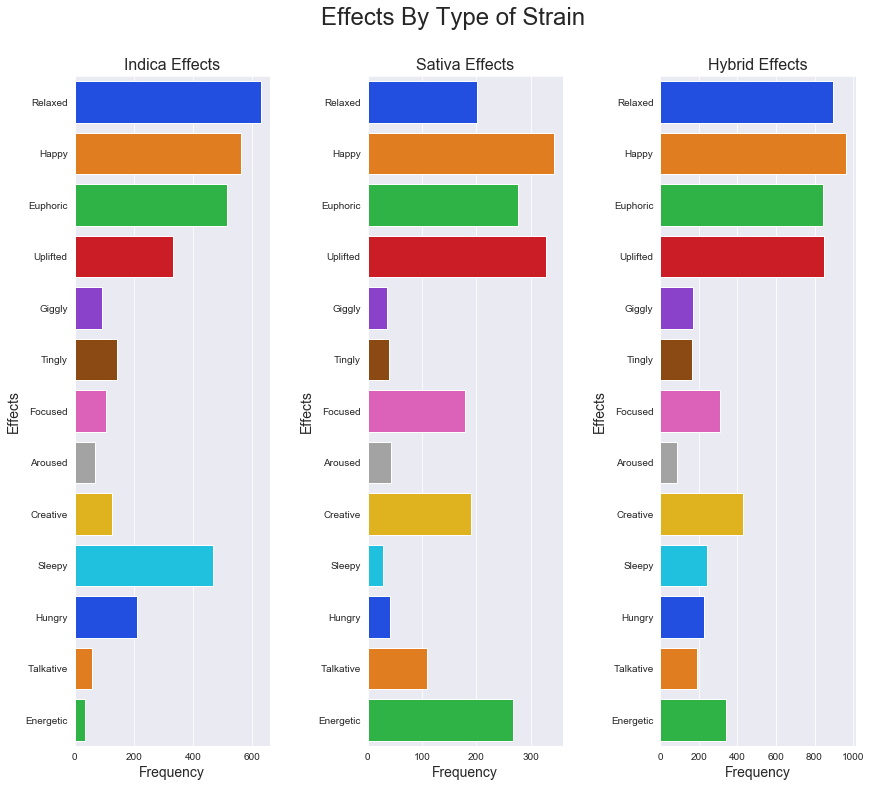

In [30]:
plt.figure(figsize=(14,12))

plt.suptitle('Effects By Type of Strain', fontsize=24)

plt.subplot(131)
ax = sns.barplot(x = "Frequency", y='Effects', 
                 order = indicas_df["Effects"].values,
                data = indicas_df, orient='h', palette = "bright")
ax.set_xlabel("Frequency", fontsize = 14)
ax.set_ylabel("Effects", fontsize=14)
ax.set_title("Indica Effects", fontsize=16)


plt.subplot(132)
ax2 = sns.barplot(x = "Frequency", y='Effects', 
                 order = indicas_df["Effects"].values,
                data = sativas_df, orient='h', palette = "bright")
ax2.set_xlabel("Frequency", fontsize = 14)
ax2.set_ylabel("Effects",fontsize = 14)
ax2.set_title("Sativa Effects", fontsize = 16)


plt.subplot(133)
ax3 = sns.barplot(x = "Frequency", y='Effects', 
                 order = indicas_df["Effects"].values,
                data = hybrids_df, orient='h', palette = "bright")
ax3.set_xlabel("Frequency", fontsize = 14)
ax3.set_ylabel("Effects", fontsize = 14)
ax3.set_title("Hybrid Effects", fontsize = 16)

plt.subplots_adjust(wspace = 0.5, top = 0.90)


plt.savefig("effects.png")
plt.show();

All three types have some effects in common, they all make us happy and euphoric. We can see that indicas help us sleep, while sativas and some hybrids keep us energetic, creative and uplifted. You can go with any strain and feel relaxed, which is good in any situation. 

This will be interesting to see when we make our recommendations, it seems as if the effects are very important when it comes to choosing what strain to try out. 

Now we'll look at what flavors are usually reported for each type of strain.

In [31]:
# Create the dataframes for the flavors
sat_flav_df = pd.DataFrame.from_dict(sat_flav, 
                                    orient = "index").reset_index().rename(columns = {"index" : "Flavors",
                                                                                     0 : "Frequency"})
sat_flav_df.head()

,Flavors,Frequency
0,Spicy/Herbal,50
1,Sage,8
2,Woody,44
3,Earthy,178
4,Flowery,38


In [32]:
ind_flav_df = pd.DataFrame.from_dict(ind_flav, 
                                    orient = "index").reset_index().rename(columns = {"index" : "Flavors",
                                                                                     0 : "Frequency"})
ind_flav_df.head()

,Flavors,Frequency
0,Citrus,83
1,Pungent,157
2,Earthy,378
3,Grape,69
4,Sweet,312


In [33]:
hy_flav_df = pd.DataFrame.from_dict(hy_flav, 
                                    orient = "index").reset_index().rename(columns = {"index" : "Flavors",
                                                                                     0 : "Frequency"})
hy_flav_df.head()

,Flavors,Frequency
0,Earthy,548
1,Sweet,532
2,Citrus,299
3,Flowery,134
4,Violet,5


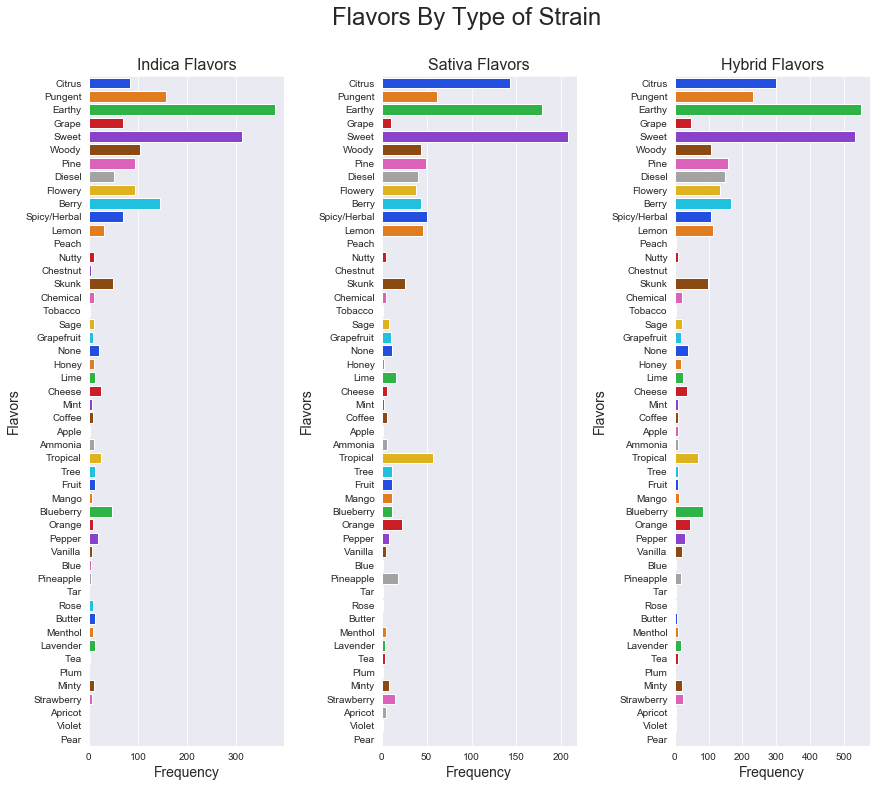

In [34]:
plt.figure(figsize=(14,12))

plt.suptitle("Flavors By Type of Strain", fontsize=24)

plt.subplot(131)
ax4 = sns.barplot(x = "Frequency", y='Flavors', 
                 order = ind_flav_df["Flavors"].values,
                data = ind_flav_df, orient='h', palette = "bright")
ax4.set_xlabel("Frequency", fontsize = 14)
ax4.set_ylabel("Flavors", fontsize=14)
ax4.set_title("Indica Flavors", fontsize=16)


plt.subplot(132)
ax5 = sns.barplot(x = "Frequency", y='Flavors', 
                 order = ind_flav_df["Flavors"].values,
                data = sat_flav_df, orient='h', palette = "bright")
ax5.set_xlabel("Frequency", fontsize = 14)
ax5.set_ylabel("Flavors",fontsize = 14)
ax5.set_title("Sativa Flavors", fontsize = 16)


plt.subplot(133)
ax6 = sns.barplot(x = "Frequency", y='Flavors', 
                 order = ind_flav_df["Flavors"].values,
                data = hy_flav_df, orient='h', palette = "bright")
ax6.set_xlabel("Frequency", fontsize = 14)
ax6.set_ylabel("Flavors", fontsize = 14)
ax6.set_title("Hybrid Flavors", fontsize = 16)

plt.subplots_adjust(wspace = 0.5, top = 0.90)

plt.show();

The most reported flavors for the three types of strains is "earthy" and "sweet", while the "citrus" flavor makes sativas and hybrids standout. Indicas definitely standout because of the pungent smell of their smoke. Since the three types share common flavors, this might cause the recommendation system to give a variety in suggestions of strains. Even though you might have input a sativa type strain into the recommender, the suggestions could include a hybrid type because of the similar flavors they share.  

From the information from the two plots I can say that when looking for a new strain to try out, the effects will be important in seeing if our recommendations make sense.

## Model and Interpret

Using One-hot encoding I will give a numerical value to my features in order to apply the distance metrics needed in my content-based recommendation system.

In [35]:
# One-hot encoding using get_dummies
effects_df = raw_df.set_index("Strain")["Effects"].str.get_dummies(",").add_suffix("_effect")
effects_df

,Aroused_effect,Creative_effect,Dry_effect,Energetic_effect,Euphoric_effect,Focused_effect,Giggly_effect,Happy_effect,Hungry_effect,Mouth_effect,Relaxed_effect,Sleepy_effect,Talkative_effect,Tingly_effect,Uplifted_effect
Strain,,,,,,,,,,,,,,,
100-Og,0,1,0,1,1,0,0,0,0,0,1,0,0,1,0
98-White-Widow,1,1,0,1,0,0,0,1,0,0,1,0,0,0,0
1024,0,1,0,1,0,0,0,1,0,0,1,0,0,0,1
13-Dawgs,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1
24K-Gold,0,0,0,0,1,0,0,1,0,0,1,0,1,0,1
3-Kings,0,0,0,0,1,0,0,1,1,0,1,0,0,0,1
303-Og,0,0,0,0,1,0,1,1,0,0,1,0,0,0,1
3D-Cbd,0,0,0,0,0,1,0,1,0,0,1,0,1,0,1
3X-Crazy,0,0,0,0,1,0,0,1,0,0,1,0,0,1,1


In [36]:
flavor_df = (raw_df.set_index("Strain")["Flavor"].str.get_dummies(",").add_suffix("_flavor"))
flavor_df.head()

,Ammonia_flavor,Apple_flavor,Apricot_flavor,Berry_flavor,Blue_flavor,Blueberry_flavor,Butter_flavor,Cheese_flavor,Chemical_flavor,Chestnut_flavor,Citrus_flavor,Coffee_flavor,Diesel_flavor,Earthy_flavor,Flowery_flavor,Fruit_flavor,Grape_flavor,Grapefruit_flavor,Honey_flavor,Lavender_flavor,Lemon_flavor,Lime_flavor,Mango_flavor,Menthol_flavor,Mint_flavor,Minty_flavor,None_flavor,Nutty_flavor,Orange_flavor,Peach_flavor,Pear_flavor,Pepper_flavor,Pine_flavor,Pineapple_flavor,Plum_flavor,Pungent_flavor,Rose_flavor,Sage_flavor,Skunk_flavor,Spicy/Herbal_flavor,Strawberry_flavor,Sweet_flavor,Tar_flavor,Tea_flavor,Tobacco_flavor,Tree_flavor,Tropical_flavor,Vanilla_flavor,Violet_flavor,Woody_flavor
Strain,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100-Og,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
98-White-Widow,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1024,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1
13-Dawgs,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
24K-Gold,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [37]:
type_df = raw_df.set_index("Strain")["Type"].str.get_dummies(",").add_suffix("_Type")
type_df

,hybrid_Type,indica_Type,sativa_Type
Strain,,,
100-Og,1,0,0
98-White-Widow,1,0,0
1024,0,0,1
13-Dawgs,1,0,0
24K-Gold,1,0,0
3-Kings,1,0,0
303-Og,0,1,0
3D-Cbd,0,0,1
3X-Crazy,0,1,0


In [38]:
# Reseting index for merging of Dataframes
effects_df = effects_df.reset_index()
effects_df.head()

,Strain,Aroused_effect,Creative_effect,Dry_effect,Energetic_effect,Euphoric_effect,Focused_effect,Giggly_effect,Happy_effect,Hungry_effect,Mouth_effect,Relaxed_effect,Sleepy_effect,Talkative_effect,Tingly_effect,Uplifted_effect
0,100-Og,0,1,0,1,1,0,0,0,0,0,1,0,0,1,0
1,98-White-Widow,1,1,0,1,0,0,0,1,0,0,1,0,0,0,0
2,1024,0,1,0,1,0,0,0,1,0,0,1,0,0,0,1
3,13-Dawgs,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1
4,24K-Gold,0,0,0,0,1,0,0,1,0,0,1,0,1,0,1


In [39]:
# Reseting index for merging of Dataframes
flavor_df = flavor_df.reset_index()
flavor_df.head()

,Strain,Ammonia_flavor,Apple_flavor,Apricot_flavor,Berry_flavor,Blue_flavor,Blueberry_flavor,Butter_flavor,Cheese_flavor,Chemical_flavor,Chestnut_flavor,Citrus_flavor,Coffee_flavor,Diesel_flavor,Earthy_flavor,Flowery_flavor,Fruit_flavor,Grape_flavor,Grapefruit_flavor,Honey_flavor,Lavender_flavor,Lemon_flavor,Lime_flavor,Mango_flavor,Menthol_flavor,Mint_flavor,Minty_flavor,None_flavor,Nutty_flavor,Orange_flavor,Peach_flavor,Pear_flavor,Pepper_flavor,Pine_flavor,Pineapple_flavor,Plum_flavor,Pungent_flavor,Rose_flavor,Sage_flavor,Skunk_flavor,Spicy/Herbal_flavor,Strawberry_flavor,Sweet_flavor,Tar_flavor,Tea_flavor,Tobacco_flavor,Tree_flavor,Tropical_flavor,Vanilla_flavor,Violet_flavor,Woody_flavor
0,100-Og,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
1,98-White-Widow,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,1024,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1
3,13-Dawgs,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,24K-Gold,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [40]:
# Reseting index for merging of Dataframes
type_df = type_df.reset_index()
type_df.head()

,Strain,hybrid_Type,indica_Type,sativa_Type
0,100-Og,1,0,0
1,98-White-Widow,1,0,0
2,1024,0,0,1
3,13-Dawgs,1,0,0
4,24K-Gold,1,0,0


In [41]:
strain_df = pd.merge(type_df, effects_df, on = ["Strain"])
strain_df.head()

,Strain,hybrid_Type,indica_Type,sativa_Type,Aroused_effect,Creative_effect,Dry_effect,Energetic_effect,Euphoric_effect,Focused_effect,Giggly_effect,Happy_effect,Hungry_effect,Mouth_effect,Relaxed_effect,Sleepy_effect,Talkative_effect,Tingly_effect,Uplifted_effect
0,100-Og,1,0,0,0,1,0,1,1,0,0,0,0,0,1,0,0,1,0
1,98-White-Widow,1,0,0,1,1,0,1,0,0,0,1,0,0,1,0,0,0,0
2,1024,0,0,1,0,1,0,1,0,0,0,1,0,0,1,0,0,0,1
3,13-Dawgs,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1
4,24K-Gold,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,1


In [42]:
final_strain_df = pd.merge(strain_df, flavor_df, on = ["Strain"])
final_strain_df.head()

,Strain,hybrid_Type,indica_Type,sativa_Type,Aroused_effect,Creative_effect,Dry_effect,Energetic_effect,Euphoric_effect,Focused_effect,Giggly_effect,Happy_effect,Hungry_effect,Mouth_effect,Relaxed_effect,Sleepy_effect,Talkative_effect,Tingly_effect,Uplifted_effect,Ammonia_flavor,Apple_flavor,Apricot_flavor,Berry_flavor,Blue_flavor,Blueberry_flavor,Butter_flavor,Cheese_flavor,Chemical_flavor,Chestnut_flavor,Citrus_flavor,Coffee_flavor,Diesel_flavor,Earthy_flavor,Flowery_flavor,Fruit_flavor,Grape_flavor,Grapefruit_flavor,Honey_flavor,Lavender_flavor,Lemon_flavor,Lime_flavor,Mango_flavor,Menthol_flavor,Mint_flavor,Minty_flavor,None_flavor,Nutty_flavor,Orange_flavor,Peach_flavor,Pear_flavor,Pepper_flavor,Pine_flavor,Pineapple_flavor,Plum_flavor,Pungent_flavor,Rose_flavor,Sage_flavor,Skunk_flavor,Spicy/Herbal_flavor,Strawberry_flavor,Sweet_flavor,Tar_flavor,Tea_flavor,Tobacco_flavor,Tree_flavor,Tropical_flavor,Vanilla_flavor,Violet_flavor,Woody_flavor
0,100-Og,1,0,0,0,1,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
1,98-White-Widow,1,0,0,1,1,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,1024,0,0,1,0,1,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1
3,13-Dawgs,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,24K-Gold,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [43]:
final_strain_df.to_csv("final_strain.csv", index = False)

In [44]:
final_strain_df.describe()

,hybrid_Type,indica_Type,sativa_Type,Aroused_effect,Creative_effect,Dry_effect,Energetic_effect,Euphoric_effect,Focused_effect,Giggly_effect,Happy_effect,Hungry_effect,Mouth_effect,Relaxed_effect,Sleepy_effect,Talkative_effect,Tingly_effect,Uplifted_effect,Ammonia_flavor,Apple_flavor,Apricot_flavor,Berry_flavor,Blue_flavor,Blueberry_flavor,Butter_flavor,Cheese_flavor,Chemical_flavor,Chestnut_flavor,Citrus_flavor,Coffee_flavor,Diesel_flavor,Earthy_flavor,Flowery_flavor,Fruit_flavor,Grape_flavor,Grapefruit_flavor,Honey_flavor,Lavender_flavor,Lemon_flavor,Lime_flavor,Mango_flavor,Menthol_flavor,Mint_flavor,Minty_flavor,None_flavor,Nutty_flavor,Orange_flavor,Peach_flavor,Pear_flavor,Pepper_flavor,Pine_flavor,Pineapple_flavor,Plum_flavor,Pungent_flavor,Rose_flavor,Sage_flavor,Skunk_flavor,Spicy/Herbal_flavor,Strawberry_flavor,Sweet_flavor,Tar_flavor,Tea_flavor,Tobacco_flavor,Tree_flavor,Tropical_flavor,Vanilla_flavor,Violet_flavor,Woody_flavor
count,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000,2263.000000
mean,0.513478,0.300486,0.186036,0.087936,0.330093,0.000442,0.285462,0.722050,0.262925,0.131684,0.826337,0.211224,0.000442,0.762262,0.325674,0.159081,0.152894,0.665930,0.012373,0.007070,0.003977,0.156871,0.003977,0.064074,0.008396,0.028281,0.016350,0.003093,0.231993,0.010605,0.106054,0.487848,0.117543,0.015024,0.055678,0.016792,0.013699,0.016350,0.083517,0.023420,0.014141,0.010163,0.007954,0.018118,0.032258,0.011047,0.034026,0.002209,0.001326,0.025630,0.132567,0.018559,0.000884,0.199293,0.007070,0.017234,0.076889,0.099426,0.020769,0.464428,0.003535,0.007512,0.003977,0.015024,0.067609,0.015024,0.003093,0.112682
std,0.499929,0.458571,0.389222,0.283265,0.470350,0.021021,0.451734,0.448087,0.440320,0.338221,0.378903,0.408267,0.021021,0.425792,0.468730,0.365832,0.359965,0.471769,0.110568,0.083806,0.062952,0.363760,0.062952,0.244939,0.091264,0.165811,0.126845,0.055543,0.422198,0.102458,0.307975,0.499963,0.322137,0.121676,0.229350,0.128519,0.116262,0.126845,0.276724,0.151267,0.118096,0.100323,0.088850,0.133406,0.176724,0.104547,0.181335,0.046963,0.036394,0.158063,0.339182,0.134993,0.029722,0.399557,0.083806,0.130170,0.266474,0.299299,0.142641,0.498843,0.059365,0.086366,0.062952,0.121676,0.251130,0.121676,0.055543,0.316274
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0

In [45]:
final_strain_df.shape

(2263, 69)

Now that I have numerical values for my features I have increased the dimensionality of my dataset and it will be difficult to visualize. In order to be able look at the data now I will use t-SNE, or t-Distributed Stochastic Neighbor Embedding. This is a dimensionality reduction technique that changes high dimensional data and turns it into a smaller dimensional space. It works by preserving small pairwise distances.  

In [46]:
from sklearn.manifold import TSNE

In [47]:
tsne = TSNE(random_state=1, n_iter=2000, metric="cosine")

In [48]:
final_strain = pd.read_csv("final_strain.csv")
final_strain.head()

,Strain,hybrid_Type,indica_Type,sativa_Type,Aroused_effect,Creative_effect,Dry_effect,Energetic_effect,Euphoric_effect,Focused_effect,Giggly_effect,Happy_effect,Hungry_effect,Mouth_effect,Relaxed_effect,Sleepy_effect,Talkative_effect,Tingly_effect,Uplifted_effect,Ammonia_flavor,Apple_flavor,Apricot_flavor,Berry_flavor,Blue_flavor,Blueberry_flavor,Butter_flavor,Cheese_flavor,Chemical_flavor,Chestnut_flavor,Citrus_flavor,Coffee_flavor,Diesel_flavor,Earthy_flavor,Flowery_flavor,Fruit_flavor,Grape_flavor,Grapefruit_flavor,Honey_flavor,Lavender_flavor,Lemon_flavor,Lime_flavor,Mango_flavor,Menthol_flavor,Mint_flavor,Minty_flavor,None_flavor,Nutty_flavor,Orange_flavor,Peach_flavor,Pear_flavor,Pepper_flavor,Pine_flavor,Pineapple_flavor,Plum_flavor,Pungent_flavor,Rose_flavor,Sage_flavor,Skunk_flavor,Spicy/Herbal_flavor,Strawberry_flavor,Sweet_flavor,Tar_flavor,Tea_flavor,Tobacco_flavor,Tree_flavor,Tropical_flavor,Vanilla_flavor,Violet_flavor,Woody_flavor
0,100-Og,1,0,0,0,1,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
1,98-White-Widow,1,0,0,1,1,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,1024,0,0,1,0,1,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1
3,13-Dawgs,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,24K-Gold,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [49]:
final_strain.columns

Index(['Strain', 'hybrid_Type', 'indica_Type', 'sativa_Type', 'Aroused_effect',
       'Creative_effect', 'Dry_effect', 'Energetic_effect', 'Euphoric_effect',
       'Focused_effect', 'Giggly_effect', 'Happy_effect', 'Hungry_effect',
       'Mouth_effect', 'Relaxed_effect', 'Sleepy_effect', 'Talkative_effect',
       'Tingly_effect', 'Uplifted_effect', 'Ammonia_flavor', 'Apple_flavor',
       'Apricot_flavor', 'Berry_flavor', 'Blue_flavor', 'Blueberry_flavor',
       'Butter_flavor', 'Cheese_flavor', 'Chemical_flavor', 'Chestnut_flavor',
       'Citrus_flavor', 'Coffee_flavor', 'Diesel_flavor', 'Earthy_flavor',
       'Flowery_flavor', 'Fruit_flavor', 'Grape_flavor', 'Grapefruit_flavor',
       'Honey_flavor', 'Lavender_flavor', 'Lemon_flavor', 'Lime_flavor',
       'Mango_flavor', 'Menthol_flavor', 'Mint_flavor', 'Minty_flavor',
       'None_flavor', 'Nutty_flavor', 'Orange_flavor', 'Peach_flavor',
       'Pear_flavor', 'Pepper_flavor', 'Pine_flavor', 'Pineapple_flavor',
       'Plum_

In [50]:
feature_mask = ['hybrid_Type', 'indica_Type', 'sativa_Type', 'Aroused_effect',
       'Creative_effect', 'Dry_effect', 'Energetic_effect', 'Euphoric_effect',
       'Focused_effect', 'Giggly_effect', 'Happy_effect', 'Hungry_effect',
       'Mouth_effect', 'Relaxed_effect', 'Sleepy_effect', 'Talkative_effect',
       'Tingly_effect', 'Uplifted_effect', 'Ammonia_flavor', 'Apple_flavor',
       'Apricot_flavor', 'Berry_flavor', 'Blue_flavor', 'Blueberry_flavor',
       'Butter_flavor', 'Cheese_flavor', 'Chemical_flavor', 'Chestnut_flavor',
       'Citrus_flavor', 'Coffee_flavor', 'Diesel_flavor', 'Earthy_flavor',
       'Flowery_flavor', 'Fruit_flavor', 'Grape_flavor', 'Grapefruit_flavor',
       'Honey_flavor', 'Lavender_flavor', 'Lemon_flavor', 'Lime_flavor',
       'Mango_flavor', 'Menthol_flavor', 'Mint_flavor', 'Minty_flavor',
       'None_flavor', 'Nutty_flavor', 'Orange_flavor', 'Peach_flavor',
       'Pear_flavor', 'Pepper_flavor', 'Pine_flavor', 'Pineapple_flavor',
       'Plum_flavor', 'Pungent_flavor', 'Rose_flavor', 'Sage_flavor',
       'Skunk_flavor', 'Spicy/Herbal_flavor', 'Strawberry_flavor',
       'Sweet_flavor', 'Tar_flavor', 'Tea_flavor', 'Tobacco_flavor',
       'Tree_flavor', 'Tropical_flavor', 'Vanilla_flavor', 'Violet_flavor',
       'Woody_flavor']

In [51]:
X = final_strain[feature_mask].to_numpy()

In [52]:
X

array([[1, 0, 0, ..., 0, 0, 0],
       [1, 0, 0, ..., 0, 1, 0],
       [0, 0, 1, ..., 0, 0, 1],
       ...,
       [0, 1, 0, ..., 0, 0, 0],
       [0, 1, 0, ..., 0, 0, 0],
       [0, 1, 0, ..., 0, 0, 0]], dtype=int64)

In [53]:
X_embedded = tsne.fit_transform(X)
X_embedded.shape

(2263, 2)

In [54]:
final_strain["x"] = X_embedded[:,0]

In [55]:
final_strain["y"] = X_embedded[:, 1]

In [56]:
final_strain

,Strain,hybrid_Type,indica_Type,sativa_Type,Aroused_effect,Creative_effect,Dry_effect,Energetic_effect,Euphoric_effect,Focused_effect,Giggly_effect,Happy_effect,Hungry_effect,Mouth_effect,Relaxed_effect,Sleepy_effect,Talkative_effect,Tingly_effect,Uplifted_effect,Ammonia_flavor,Apple_flavor,Apricot_flavor,Berry_flavor,Blue_flavor,Blueberry_flavor,Butter_flavor,Cheese_flavor,Chemical_flavor,Chestnut_flavor,Citrus_flavor,Coffee_flavor,Diesel_flavor,Earthy_flavor,Flowery_flavor,Fruit_flavor,Grape_flavor,Grapefruit_flavor,Honey_flavor,Lavender_flavor,Lemon_flavor,Lime_flavor,Mango_flavor,Menthol_flavor,Mint_flavor,Minty_flavor,None_flavor,Nutty_flavor,Orange_flavor,Peach_flavor,Pear_flavor,Pepper_flavor,Pine_flavor,Pineapple_flavor,Plum_flavor,Pungent_flavor,Rose_flavor,Sage_flavor,Skunk_flavor,Spicy/Herbal_flavor,Strawberry_flavor,Sweet_flavor,Tar_flavor,Tea_flavor,Tobacco_flavor,Tree_flavor,Tropical_flavor,Vanilla_flavor,Violet_flavor,Woody_flavor,x,y
0,100-Og,1,0,0,0,1,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,5.010251,32.846371
1,98-White-Widow,1,0,0,1,1,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,-13.254560,21.994934
2,1024,0,0,1,0,1,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,17.069492,79.029778
3,13-Dawgs,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,31.350019,-16.986027
4,24K-Gold,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,11.137016,20.761280
5,3-Kings,1,0,0,0,0,0,0,1,0,0,1,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,-1.343234,-9.347255
6,303-Og,0,1,0,0,0,0,0,1,0,1,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,23.221426,-54.830593
7,3D-Cbd,0,0,1,0,0,0,0,0,1,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,-7.876199,68.043541
8,3X-Crazy,0,1,0,0,0,0,0,1,0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,-14.635864,-52.831646
9,3Rd-Coast-Panama-Chunk,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-10.180138,37.880726


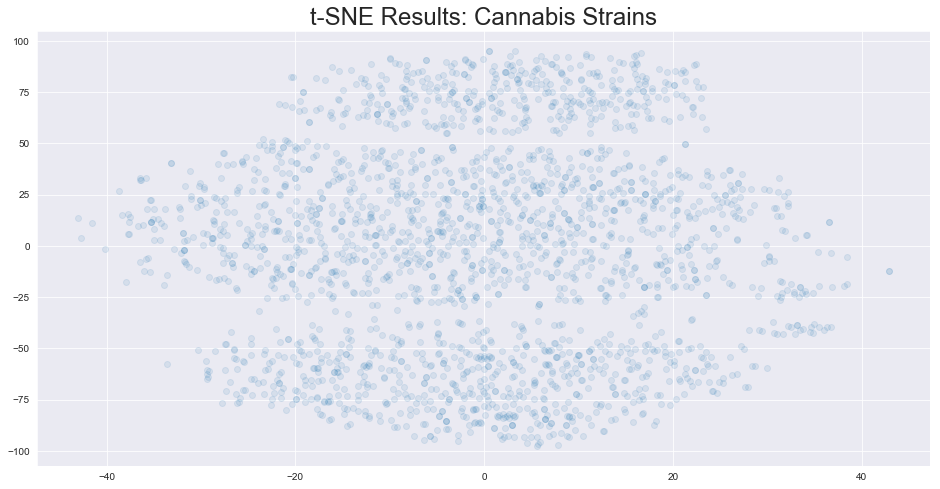

In [83]:
# PLotting the new 2d space of my data
fig_size = (16, 8)
fig, ax = plt.subplots(figsize = fig_size)
ax.scatter(final_strain.x, final_strain.y, alpha = 0.1)
ax.set_title("t-SNE Results: Cannabis Strains", fontsize = 24)
plt.savefig("t_sne_cannabis.png")
plt.show();

To get a closer look into the t-SNE plot I will implement the following functions to specifically look at certain areas within the graph to gain some insight on the data.

In [58]:
# helper functions to further plot our embeddings
try:
    from adjustText import adjust_text
except ImportError:
    def adjust_text(*args, **kwargs):
        pass

def adjust_text(*args, **kwargs):
    pass

def plot_bg(bg_alpha=.01, figsize=(16, 8), emb_2d=None):
    """Create and return a plot of all our strain embeddings with very low opacity.
    (Intended to be used as a basis for further - more prominent - plotting of a 
    subset of strains. Having the overall shape of the plot in the background is
    useful for context.)
    """
    if emb_2d is None:
        emb_2d = X_embedded
    fig, ax = plt.subplots(figsize=figsize)
    X = emb_2d[:, 0]
    Y = emb_2d[:, 1]
    ax.scatter(X, Y, alpha=bg_alpha)
    return ax

def plot_with_annotations(label_indices, text=True, labels=None, alpha=1, **kwargs):
    ax = plot_bg(**kwargs)
    Xlabeled = X_embedded[label_indices, 0]
    Ylabeled = X_embedded[label_indices, 1]
    if labels is not None:
        for x, y, label in zip(Xlabeled, Ylabeled, labels):
            ax.scatter(x, y, alpha=alpha, label=label, marker='1',
                       s=90,
                      )
        fig.legend()
    else:
        ax.scatter(Xlabeled, Ylabeled, alpha=alpha, color='green')
    
    if text:
        # TODO: Add abbreviated title column
        strains = final_strain.loc[label_indices, 'Strain'].values
        texts = []
        for label, x, y in zip(strains, Xlabeled, Ylabeled):
            t = ax.annotate(label, xy=(x, y))
            texts.append(t)
        adjust_text(texts, 
                    #expand_text=(1.01, 1.05),
                    arrowprops=dict(arrowstyle='->', color='red'),
                   )
    return ax

def plot_by_title_pattern(pattern, **kwargs):
    """Plot all type of strains whose names match the given regex pattern.
    """
    match = final_strain[final_strain.Strain.str.contains(pattern)]
    return plot_with_annotations(match.index, **kwargs)

FS = (13, 9)
def plot_region(x0, x1, y0, y1, text=True):
    """Plot the region of the mapping space bounded by the given x and y limits.
    """
    fig, ax = plt.subplots(figsize=FS)
    pts = final_strain[
        (final_strain.x >= x0) & (final_strain.x <= x1)
        & (final_strain.y >= y0) & (final_strain.y <= y1)
    ]
    ax.scatter(pts.x, pts.y, alpha=.6)
    ax.set_xlim(x0, x1)
    ax.set_ylim(y0, y1)
    if text:
        texts = []
        for label, x, y in zip(pts.Strain.values, pts.x.values, pts.y.values):
            t = ax.annotate(label, xy=(x, y))
            texts.append(t)
        adjust_text(texts, expand_text=(1.01, 1.05))
    return ax

def plot_region_around(name, margin=5, **kwargs):
    """Plot the region of the mapping space in the neighbourhood of the the strain with
    the given name. The margin parameter controls the size of the neighbourhood around
    the movie.
    """
    xmargin = ymargin = margin
    match = final_strain[final_strain.Strain == name]
    assert len(match) == 1
    row = match.iloc[0]
    return plot_region(row.x-xmargin, row.x+xmargin, row.y-ymargin, row.y+ymargin, **kwargs)

First we will take a look at where each type of strain falls within the plot.

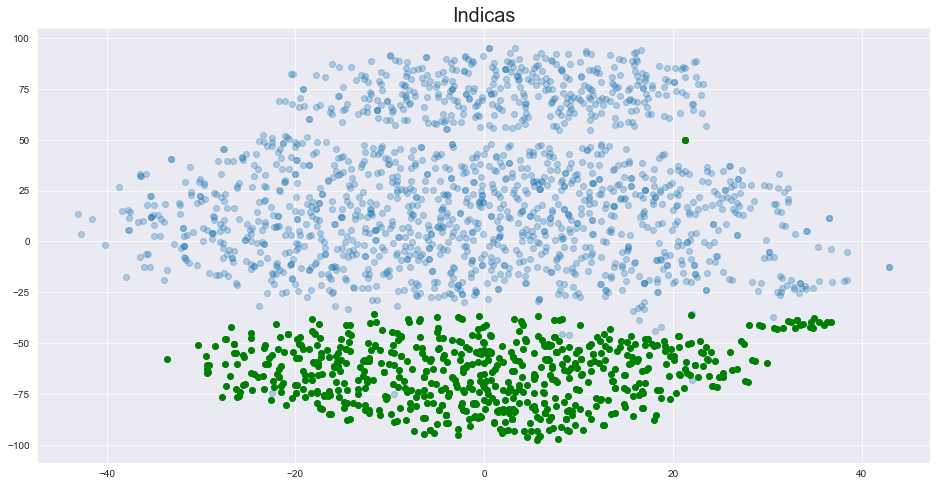

In [59]:
indicas = final_strain[final_strain.indica_Type == 1]
plot_with_annotations(indicas.index, bg_alpha = 0.3, text = False, 
                      figsize = (16, 8))
plt.title("Indicas", fontsize = 20);

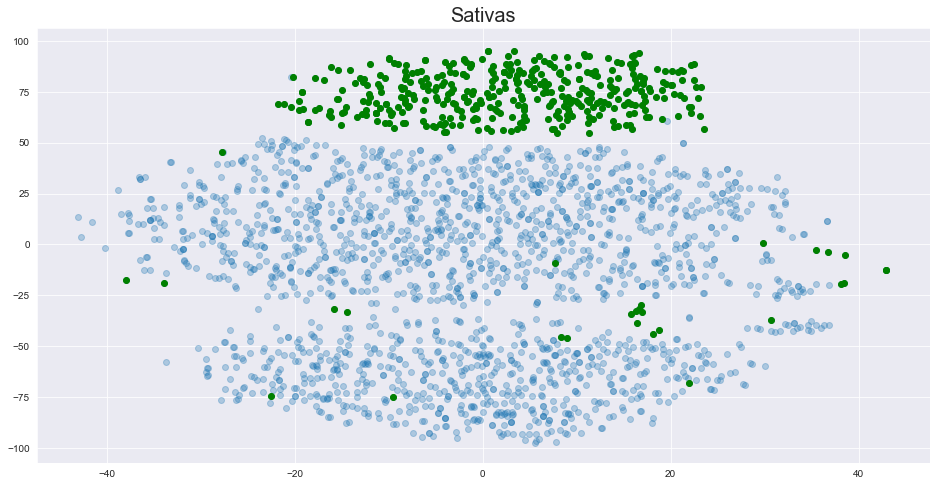

In [60]:
sativas = final_strain[final_strain.sativa_Type == 1]
plot_with_annotations(sativas.index, bg_alpha = 0.3, text = False, 
                      figsize = (16, 8))
plt.title("Sativas", fontsize= 20);

Interesting, we can see that some sativas have been grouped closely with some indicas as well as hybrids. It is expected for some sativas to be close to hybrids knowing that a lot of hybrids are sativa-dominant. For them to be close to indicas is very strange but it could be that they share some common effects.

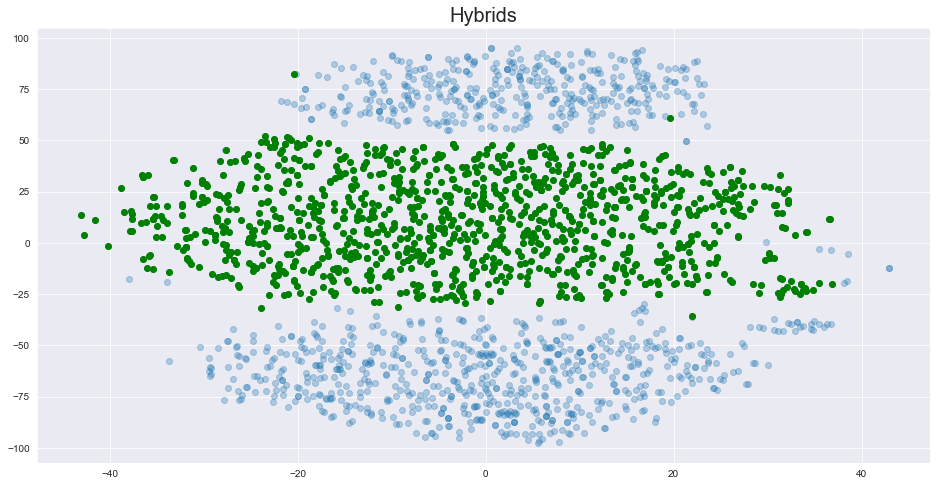

In [61]:
hybrids = final_strain[final_strain.hybrid_Type == 1]
plot_with_annotations(hybrids.index, bg_alpha = 0.3, text = False, 
                      figsize = (16, 8))
plt.title("Hybrids", fontsize = 20);

The hybrid type takes up most of the space in the plot which makes sense because they make up for most of the data points in the dataset. We can also see that some are very close to the sativa type rather than the indica type. I suppose most customers want some of the effects of indicas but with more of the effects of the sativa type(no sleepiness).

Now we will take a look at where the strains that contain the pattern "Og" in its name are, this nomenclature is associated to one of the most popular strains around, and it has been cloned with many other strains as well. 

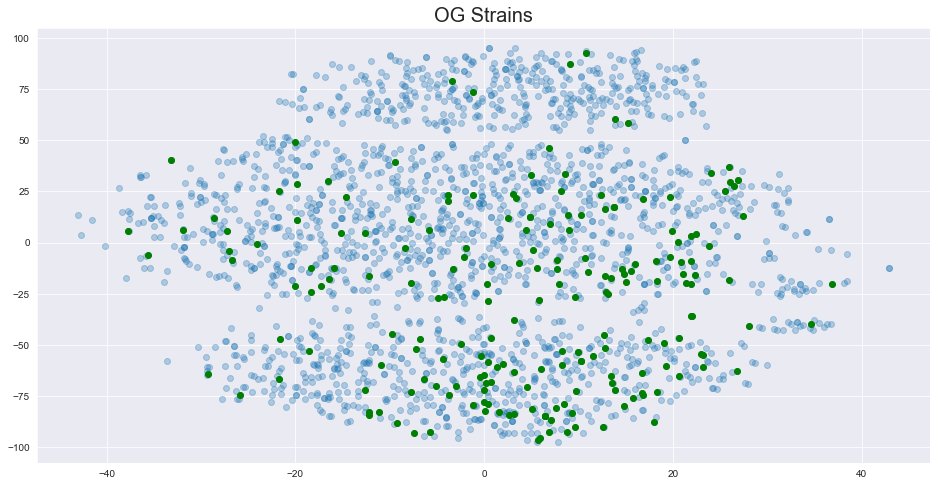

In [62]:
plot_by_title_pattern("Og", figsize = (16, 8), bg_alpha = 0.3, text = False)
plt.title("OG Strains", fontsize= 20);

Well we can see that the OG strains mainly lie with the hybrid and indica types. This tells us that the OG strains must have relaxing and sleepy effects, although some are in the sativa area, but this just means that they might share the effect of happiness or euphoria as we saw in the effects distribution above.

Sativas are well known for their creative and energetic effects, lets see if the other strain types share these effects as well.

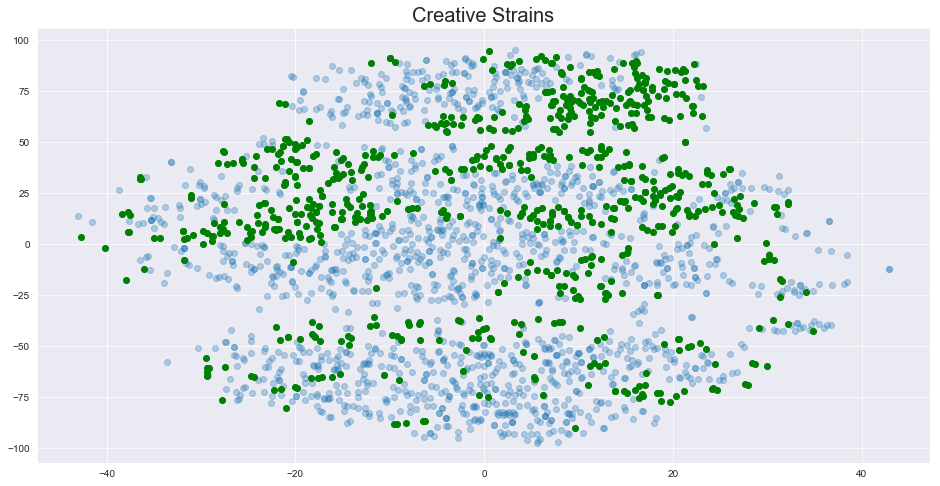

In [63]:
creatives = final_strain[final_strain.Creative_effect == 1]
plot_with_annotations(creatives.index, bg_alpha = 0.3, text = False,
                     figsize = (16, 8))
plt.title("Creative Strains", fontsize= 20);

There seems to be a great variety of strains that offer the creative effect, even within the indicas which lean more towards a "body-high" effect. The majority of them are in found in sativas and hybrids. Now lets look at how the energetic effects are spread out.

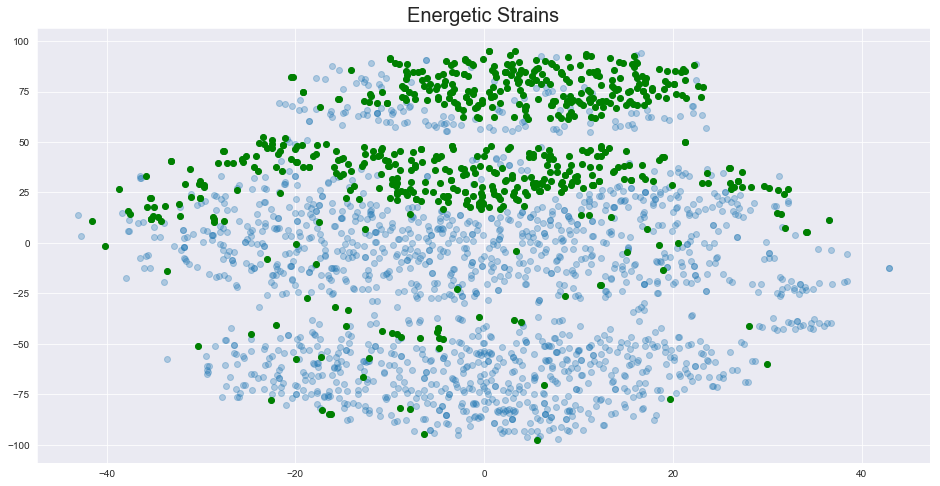

In [64]:
energetics = final_strain[final_strain.Energetic_effect == 1]
plot_with_annotations(energetics.index, bg_alpha = 0.3, text = False,
                     figsize = (16, 8))
plt.title("Energetic Strains", fontsize= 20);

As expected most of the energy is with the sativas and hybrids that are sativa-dominant. Some are found with indicas but its probably because they have been cloned with a strong sativa strain. The customer that prefers indicas but needs more energy and creativeness can still find it within their preference.

Now I will begin to build my content-based recommender, I will use cosine similarity as a distance metric to get the data points that are closest to the input. 

Cosine similarity measures the cosine of the angle between two vectors, if the angle between the vectors is 0 then the similarity is calculated as 1 because the cosine of 0 = 1. This means that the vectors are the same. Similarity will be between 0 and 1, meaning that the closer you are to 1 the more similar the vectors are.

In [65]:
from sklearn.metrics.pairwise import cosine_similarity

In [66]:
final_copy = final_strain.copy()
final_copy.head()

,Strain,hybrid_Type,indica_Type,sativa_Type,Aroused_effect,Creative_effect,Dry_effect,Energetic_effect,Euphoric_effect,Focused_effect,Giggly_effect,Happy_effect,Hungry_effect,Mouth_effect,Relaxed_effect,Sleepy_effect,Talkative_effect,Tingly_effect,Uplifted_effect,Ammonia_flavor,Apple_flavor,Apricot_flavor,Berry_flavor,Blue_flavor,Blueberry_flavor,Butter_flavor,Cheese_flavor,Chemical_flavor,Chestnut_flavor,Citrus_flavor,Coffee_flavor,Diesel_flavor,Earthy_flavor,Flowery_flavor,Fruit_flavor,Grape_flavor,Grapefruit_flavor,Honey_flavor,Lavender_flavor,Lemon_flavor,Lime_flavor,Mango_flavor,Menthol_flavor,Mint_flavor,Minty_flavor,None_flavor,Nutty_flavor,Orange_flavor,Peach_flavor,Pear_flavor,Pepper_flavor,Pine_flavor,Pineapple_flavor,Plum_flavor,Pungent_flavor,Rose_flavor,Sage_flavor,Skunk_flavor,Spicy/Herbal_flavor,Strawberry_flavor,Sweet_flavor,Tar_flavor,Tea_flavor,Tobacco_flavor,Tree_flavor,Tropical_flavor,Vanilla_flavor,Violet_flavor,Woody_flavor,x,y
0,100-Og,1,0,0,0,1,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,5.010251,32.846371
1,98-White-Widow,1,0,0,1,1,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,-13.254560,21.994934
2,1024,0,0,1,0,1,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,17.069492,79.029778
3,13-Dawgs,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,31.350019,-16.986027
4,24K-Gold,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,11.137016,20.761280


In [67]:
# Dropping the t-SNE embeddings and the Strain column
final_copy.drop(columns=["x", "y", "Strain"], inplace=True)
final_copy.head()

,hybrid_Type,indica_Type,sativa_Type,Aroused_effect,Creative_effect,Dry_effect,Energetic_effect,Euphoric_effect,Focused_effect,Giggly_effect,Happy_effect,Hungry_effect,Mouth_effect,Relaxed_effect,Sleepy_effect,Talkative_effect,Tingly_effect,Uplifted_effect,Ammonia_flavor,Apple_flavor,Apricot_flavor,Berry_flavor,Blue_flavor,Blueberry_flavor,Butter_flavor,Cheese_flavor,Chemical_flavor,Chestnut_flavor,Citrus_flavor,Coffee_flavor,Diesel_flavor,Earthy_flavor,Flowery_flavor,Fruit_flavor,Grape_flavor,Grapefruit_flavor,Honey_flavor,Lavender_flavor,Lemon_flavor,Lime_flavor,Mango_flavor,Menthol_flavor,Mint_flavor,Minty_flavor,None_flavor,Nutty_flavor,Orange_flavor,Peach_flavor,Pear_flavor,Pepper_flavor,Pine_flavor,Pineapple_flavor,Plum_flavor,Pungent_flavor,Rose_flavor,Sage_flavor,Skunk_flavor,Spicy/Herbal_flavor,Strawberry_flavor,Sweet_flavor,Tar_flavor,Tea_flavor,Tobacco_flavor,Tree_flavor,Tropical_flavor,Vanilla_flavor,Violet_flavor,Woody_flavor
0,1,0,0,0,1,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
1,1,0,0,1,1,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,0,0,1,0,1,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1
3,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [68]:
co_sim = cosine_similarity(final_copy, final_copy)

In [69]:
co_sim

array([[1.        , 0.44444444, 0.33333333, ..., 0.44444444, 0.44444444,
        0.22222222],
       [0.44444444, 1.        , 0.44444444, ..., 0.22222222, 0.22222222,
        0.22222222],
       [0.33333333, 0.44444444, 1.        , ..., 0.33333333, 0.22222222,
        0.33333333],
       ...,
       [0.44444444, 0.22222222, 0.33333333, ..., 1.        , 0.77777778,
        0.55555556],
       [0.44444444, 0.22222222, 0.22222222, ..., 0.77777778, 1.        ,
        0.77777778],
       [0.22222222, 0.22222222, 0.33333333, ..., 0.55555556, 0.77777778,
        1.        ]])

In [70]:
co_sim.shape

(2263, 2263)

In [71]:
# Making a series of indices to display the recommendations
indices = pd.Series(final_strain.index, index=final_strain["Strain"]).drop_duplicates()

In [72]:
indices[:10]

Strain
100-Og                    0
98-White-Widow            1
1024                      2
13-Dawgs                  3
24K-Gold                  4
3-Kings                   5
303-Og                    6
3D-Cbd                    7
3X-Crazy                  8
3Rd-Coast-Panama-Chunk    9
dtype: int64

In [73]:
# Function that takes in strain name as input and outputs most similar strains
def get_recommendations(strain, cosine_sim=co_sim):
    # Get the index of the strain that matches the input
    idx = indices[strain]

    # Get the pairwise similarity scores of all strains with that initial strain
    sim_scores = list(enumerate(cosine_sim[idx]))

    # Sort the strains based on the similarity scores
    sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)

    # Get the scores of the 10 most similar strains
    sim_scores = sim_scores[1:11]

    # Get the strain indices
    strain_indices = [i[0] for i in sim_scores]

    # Return the top 10 most similar strains
    print(sim_scores)
    return final_strain["Strain"].iloc[strain_indices]    

In [74]:
# Recommendations for a hybrid type strain
OG_recomends = get_recommendations("100-Og")

[(78, 0.7777777777777779), (88, 0.7777777777777779), (96, 0.7777777777777779), (121, 0.7777777777777779), (283, 0.7777777777777779), (409, 0.7777777777777779), (432, 0.7777777777777779), (521, 0.7777777777777779), (680, 0.7777777777777779), (742, 0.7777777777777779)]


In [75]:
OG_recomends

78     Alien-Rock-Candy
88         Aloha-Limone
96       American-Dream
121             Area-51
283       Blue-Hawaiian
409       Cactus-Cooler
432       Captains-Cake
521       Cinderella-99
680         Dream-Queen
742        Eugene-Cream
Name: Strain, dtype: object

All the similarity scores are the same which makes me think that these recommendations might not be right. Lets see what they look like on our plot.

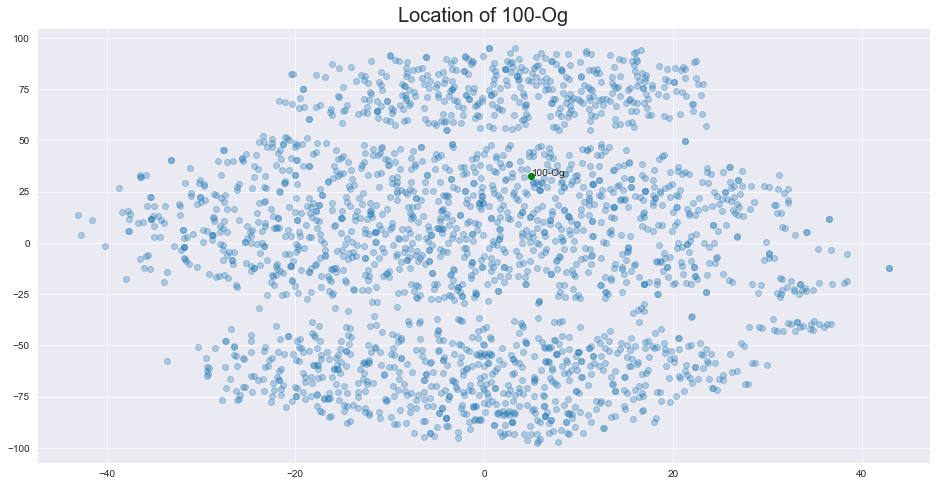

In [76]:
plot_by_title_pattern("100-Og", figsize = (16, 8), bg_alpha= 0.3, text= True)
plt.title("Location of 100-Og", fontsize = 20);

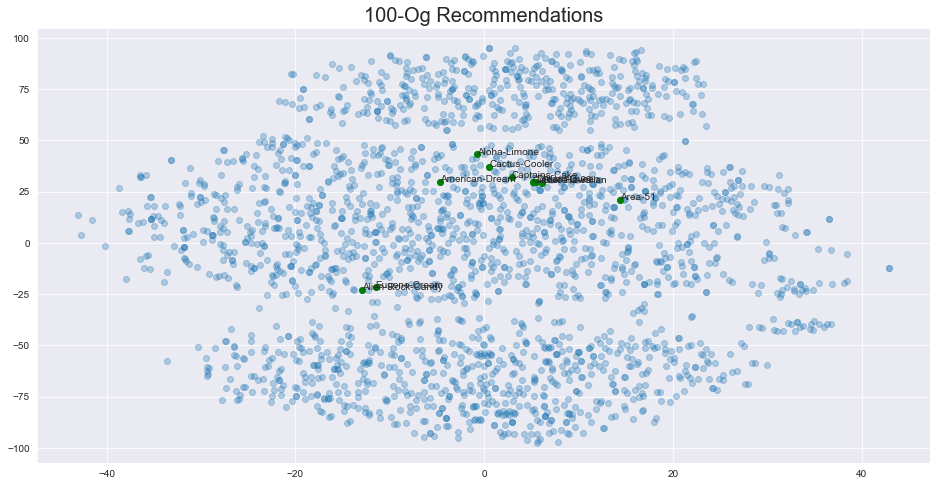

In [77]:
plot_with_annotations(OG_recomends.index, bg_alpha = 0.3, text = True,
                     figsize = (16, 8))
plt.title("100-Og Recommendations", fontsize = 20);

When comparing the location of "100-Og" to the location of the recommendations we got, it seems like the recommender is on the right track. Most of the recommendations are very close to 100-Og. Alien-Rock-Candy and Eugene-Cream seem to be a bit far from the original strain but this could be due to them being indica-dominant strains. Lets look at their effects and see how they compare.

In [78]:
print("*******************************************************")
print(raw_df.iloc[0])
print("*******************************************************")
print(raw_df.iloc[283])
print("*******************************************************")
print(raw_df.iloc[742])

*******************************************************
Strain                                         100-Og
Type                                           hybrid
Rating                                              4
Effects    Creative,Energetic,Tingly,Euphoric,Relaxed
Flavor                            Earthy,Sweet,Citrus
Name: 0, dtype: object
*******************************************************
Strain                                 Blue-Hawaiian
Type                                          hybrid
Rating                                           4.3
Effects    Happy,Uplifted,Relaxed,Euphoric,Energetic
Flavor                           Citrus,Earthy,Sweet
Name: 284, dtype: object
*******************************************************
Strain                                Eugene-Cream
Type                                        hybrid
Rating                                         4.6
Effects    Relaxed,Sleepy,Tingly,Creative,Euphoric
Flavor                         Sweet,Earthy,B

Well we can see that they all share the relaxed and euphoric effects as well as the earthy and sweet flavor. You can also see that Eugene-Cream is further away from the other recommendations because it has the sleepy effect which is always associated with indica strains, but it has a bit of versatility because of its creative effect which is always part of a sativa strain. This could be a reason why so many hybrid strains are on the market.

In [79]:
# Recommendations for a sativa type strain
sup_sil_haze_recommends = get_recommendations("Super-Silver-Haze")

[(1974, 1.0000000000000002), (25, 0.8888888888888891), (60, 0.8888888888888891), (169, 0.8888888888888891), (170, 0.8888888888888891), (283, 0.8888888888888891), (521, 0.8888888888888891), (524, 0.8888888888888891), (680, 0.8888888888888891), (692, 0.8888888888888891)]


In [80]:
sup_sil_haze_recommends

1974    Super-Silver-Haze
25          Acapulco-Gold
60            Alaskan-Ice
169                Bay-11
170             Bay-Dream
283         Blue-Hawaiian
521         Cinderella-99
524                 Cinex
680           Dream-Queen
692        Dutch-Hawaiian
Name: Strain, dtype: object

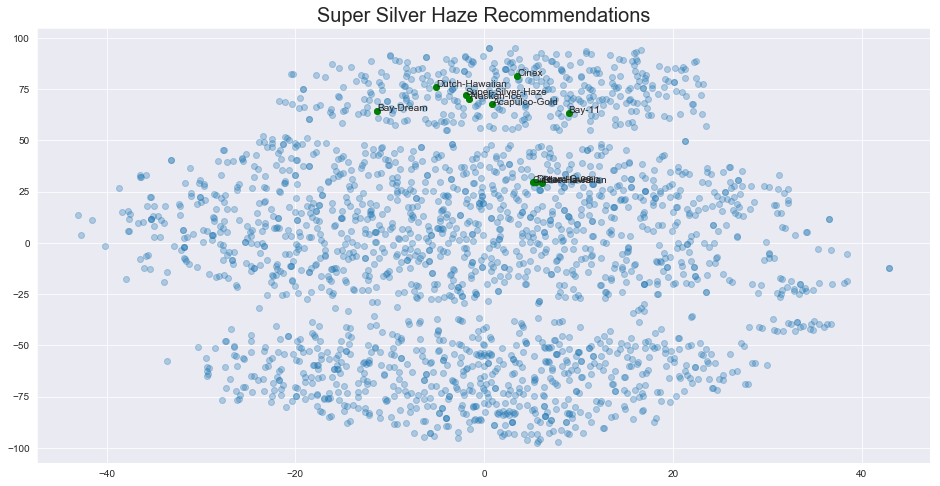

In [82]:
plot_with_annotations(sup_sil_haze_recommends.index, bg_alpha = 0.3, text = True,
                     figsize = (16, 8))
plt.title("Super Silver Haze Recommendations", fontsize = 20);
plt.savefig("ssh_recommend.png");

The strains are pretty close together with the exception of three that are in the hybrid region. This is expected because we already know that many of our hybrids have sativa effects. Now we will zoom into the hybrid region where the strains are very bunched up together, this way we can see what the strains are to compare their effects.

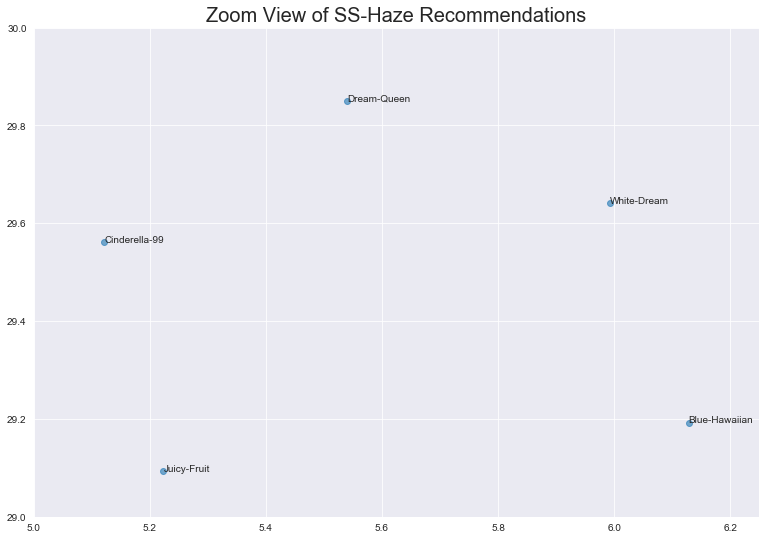

In [82]:
plot_region(x0=5, x1=6.25, y0=29, y1=30)
plt.title("Zoom View of SS-Haze Recommendations", fontsize = 20);

With a close-up look at the location of the recommendations we can see that the hybrid strains that are closest to our sativa strain are Cinderella-99, Dream-Queen, and Blue-Hawaiian comes up again. What is interesting is that White-Dream does not come up as a recommendation being that is closer to Dream-Queen and Cinderella-99. Now we will compare some of these effects to see what we can learn.

In [83]:
print("*******************************************************")
print(raw_df.iloc[1974])
print("*******************************************************")
print(raw_df.iloc[60])
print("*******************************************************")
print(raw_df.iloc[283])
print("*******************************************************")
print(raw_df.iloc[680])
print("*******************************************************")
print(raw_df.iloc[2187])

*******************************************************
Strain                             Super-Silver-Haze
Type                                          sativa
Rating                                           4.4
Effects    Happy,Uplifted,Energetic,Euphoric,Relaxed
Flavor                           Citrus,Earthy,Sweet
Name: 1975, dtype: object
*******************************************************
Strain                                   Alaskan-Ice
Type                                          sativa
Rating                                           4.4
Effects    Euphoric,Uplifted,Happy,Relaxed,Energetic
Flavor                     Sweet,Earthy,Spicy/Herbal
Name: 60, dtype: object
*******************************************************
Strain                                 Blue-Hawaiian
Type                                          hybrid
Rating                                           4.3
Effects    Happy,Uplifted,Relaxed,Euphoric,Energetic
Flavor                           Citrus,

From the comparison above we can see that the Alaskan-Ice is almost identical to Super-Silver-Haze except for the spicy/herbal flavor of the Alaskan-Ice strain. The hybrids are exactly identical to the SSH strain in their effects and flavors, yet White-Dream did not come up on the top ten. This could be because of its higher rating or simply because the recommender chose the input strain as its first choice.

In [84]:
# Recommendations for an indica strain
bubba_recommends = get_recommendations("Bubba-Kush")

[(137, 1.0000000000000002), (372, 1.0000000000000002), (501, 1.0000000000000002), (506, 1.0000000000000002), (15, 0.8888888888888891), (37, 0.8888888888888891), (41, 0.8888888888888891), (47, 0.8888888888888891), (69, 0.8888888888888891), (105, 0.8888888888888891)]


In [85]:
bubba_recommends

137    Aurora-Borealis
372         Bubba-Kush
501    Chocolate-Chunk
506     Chocolate-Kush
15      9-Pound-Hammer
37         Afghan-Kush
41             Afghani
47               Afgoo
69         Alien-Bubba
105         Anesthesia
Name: Strain, dtype: object

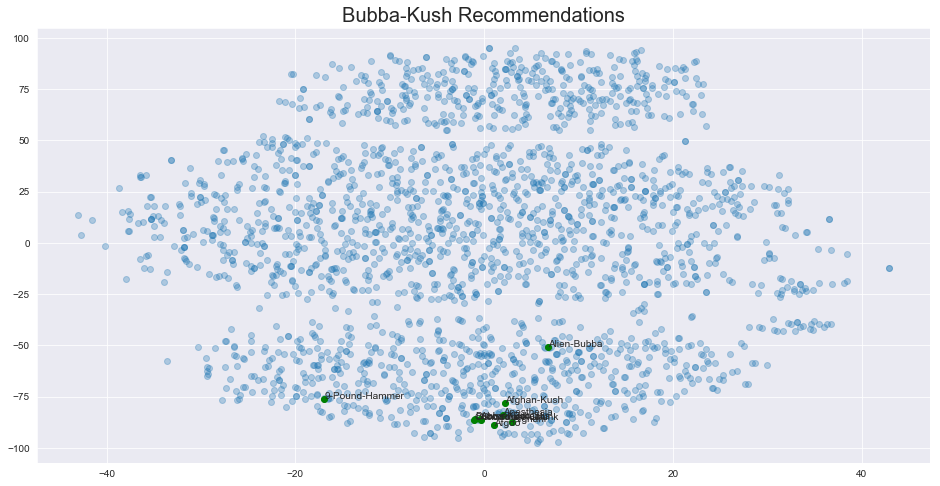

In [86]:
plot_with_annotations(bubba_recommends.index, bg_alpha = 0.3, text = True,
                     figsize = (16, 8))
plt.title("Bubba-Kush Recommendations", fontsize= 20);

This time the recommender has all of the data points in the indica region. I believe that when we compare the effects and flavors of some of these strains that they will be identical across the board. We will compare using the data points that are the furthest from the rest of the grouping to see if there is a difference. We can also see that the Kush name is used in other strains as well, like we saw with the Og strains.

In [87]:
print("*******************************************************")
print(raw_df.iloc[372])
print("*******************************************************")
print(raw_df.iloc[15])
print("*******************************************************")
print(raw_df.iloc[105])

*******************************************************
Strain                               Bubba-Kush
Type                                     indica
Rating                                      4.3
Effects    Relaxed,Happy,Sleepy,Euphoric,Hungry
Flavor                       Earthy,Sweet,Woody
Name: 373, dtype: object
*******************************************************
Strain                           9-Pound-Hammer
Type                                     indica
Rating                                      4.5
Effects    Relaxed,Sleepy,Euphoric,Happy,Hungry
Flavor                       Earthy,Sweet,Berry
Name: 15, dtype: object
*******************************************************
Strain                               Anesthesia
Type                                     indica
Rating                                      4.1
Effects    Hungry,Sleepy,Relaxed,Happy,Euphoric
Flavor                     Earthy,Pungent,Sweet
Name: 105, dtype: object


Here there are only some slight differences in between the strains, which are the change in one of the flavors. They all have an earthy and sweet taste and they all share the same type of effects including hungry, which we haven't seen in the other strains, and of course what makes an indica an indica the sleepy feeling that comes along with the relaxed and euphoric effects.

## Reducing dimensionality

In order to see if we can get something different from my raw data, I will perform PCA(principal component analysis), which is a dimensionality reduction algorithm that will take the data and return a new representation based on the structure and patterns that are within the data. I will choose the first 12 components, then it will take the 1st component and capture the max variance within the data, the other components will be independent from the previous one and will continue to account for as much as the remaining variance as posible.

Then with these new embeddings I will perform recommendations for the same strains as before and compare to see if there is any difference between the first recommendations and these new ones.

In [88]:
from sklearn.decomposition import PCA

In [89]:
from sklearn.preprocessing import StandardScaler

When performing PCA we are interested in the components that maximize the variance, in order to accomplish this the features should be standardized in a way where they have the characteristics of a standard normal distribution with a mean of zero and a standard deviation of 1.

In [90]:
# Standarizing the data
scaler = StandardScaler()
ss_df = scaler.fit_transform(final_copy)

C:\Users\teach\Anaconda3\envs\learn-env\lib\site-packages\sklearn\preprocessing\data.py:625: DataConversionWarning: Data with input dtype int64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
C:\Users\teach\Anaconda3\envs\learn-env\lib\site-packages\sklearn\base.py:462: DataConversionWarning: Data with input dtype int64 were all converted to float64 by StandardScaler.
  return self.fit(X, **fit_params).transform(X)


In [91]:
ss_df

array([[ 0.97339833, -0.65541141, -0.47807522, ..., -0.12350497,
        -0.05570311, -0.35635941],
       [ 0.97339833, -0.65541141, -0.47807522, ..., -0.12350497,
        17.9523178 , -0.35635941],
       [-1.02732866, -0.65541141,  2.09172104, ..., -0.12350497,
        -0.05570311,  2.8061557 ],
       ...,
       [-1.02732866,  1.52575921, -0.47807522, ..., -0.12350497,
        -0.05570311, -0.35635941],
       [-1.02732866,  1.52575921, -0.47807522, ..., -0.12350497,
        -0.05570311, -0.35635941],
       [-1.02732866,  1.52575921, -0.47807522, ..., -0.12350497,
        -0.05570311, -0.35635941]])

In [92]:
# Performing PCA with 12 pricinpal components
pca = PCA(n_components = 12)

In [93]:
pca.fit(ss_df)

PCA(copy=True, iterated_power='auto', n_components=12, random_state=None,
  svd_solver='auto', tol=0.0, whiten=False)

In [94]:
pca_set = pca.transform(ss_df)

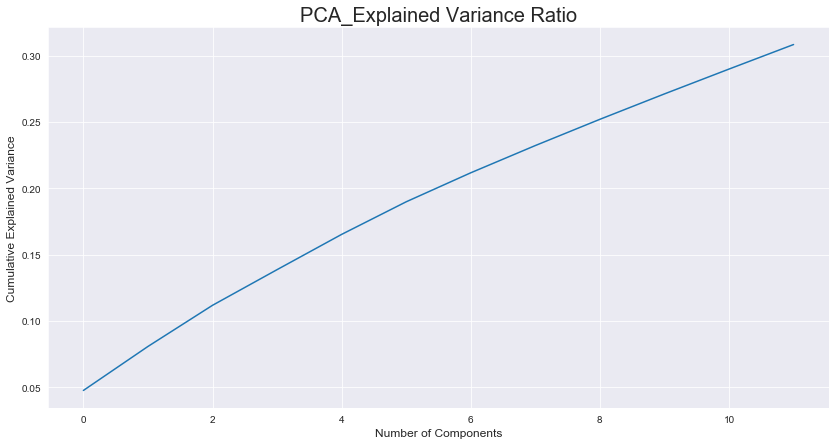

In [95]:
# PLotting the explained variance
plt.figure(figsize= (14, 7))
sns.lineplot(data=np.cumsum(pca.explained_variance_ratio_))
plt.xlabel("Number of Components", fontsize = 12)
plt.ylabel("Cumulative Explained Variance", fontsize = 12)
plt.title("PCA_Explained Variance Ratio", fontsize = 20);

As we can see from the plot above, the first 12 components only captured about 30% of the variance of the raw data, this is a big loss of information from the original data set, if this data was used in the recommendation system we would not get very good results and the recommendations might not make sense. 

Now I will perform PCA with no components selected to be able to see how many components are needed to capture at least 75% of the variance of the data. 

In [96]:
pca2 = PCA()

In [97]:
pca2.fit(ss_df)

PCA(copy=True, iterated_power='auto', n_components=None, random_state=None,
  svd_solver='auto', tol=0.0, whiten=False)

In [98]:
pca2.fit_transform(ss_df)

array([[ 9.85149455e-01,  1.58003028e-01, -4.55078521e-01, ...,
         2.78141444e-14,  1.68088763e-13,  9.85718829e-17],
       [ 1.52710395e+00,  3.89293592e-01, -3.39739745e-01, ...,
        -8.60293343e-16, -2.08080064e-14,  8.01138604e-16],
       [ 1.84129629e+00,  7.41404236e-02,  4.58653271e-01, ...,
         2.55546821e-14, -7.37057534e-16, -3.42012999e-16],
       ...,
       [-2.23065266e+00, -3.78218614e-02,  6.16948156e-01, ...,
         2.62140835e-16, -5.21879910e-17, -7.16890351e-17],
       [-3.32238545e+00, -1.39130016e-01,  1.95509582e-01, ...,
        -1.36753120e-15,  1.08339814e-16,  4.31276796e-18],
       [-2.93054106e+00, -5.58500157e-02,  1.16938002e-01, ...,
        -8.39768112e-16,  7.68542341e-16,  4.73981827e-17]])

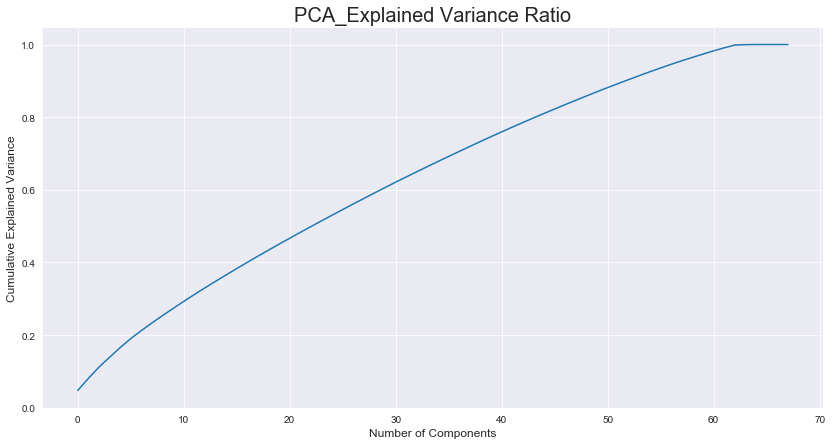

In [99]:
# PLotting the explained variance with no components selected
plt.figure(figsize= (14, 7))
sns.lineplot(data=np.cumsum(pca2.explained_variance_ratio_))
plt.xlabel("Number of Components", fontsize = 12)
plt.ylabel("Cumulative Explained Variance", fontsize = 12)
plt.title("PCA_Explained Variance Ratio", fontsize = 20);

Looking at the explained variance of our data through PCA, we can see that the number of components needed to capture 75-80% of the variance of the data is from 40-45 components. If we use more than that, the whole original data set might as well be used. 

Now I will perform PCA with 45 components and use the results with the recommendation system. 

In [100]:
pca3 = PCA(n_components= 45)

In [101]:
pca3.fit(ss_df)

PCA(copy=True, iterated_power='auto', n_components=45, random_state=None,
  svd_solver='auto', tol=0.0, whiten=False)

In [102]:
pca_set2 = pca3.transform(ss_df)

In [103]:
pca_set2.shape

(2263, 45)

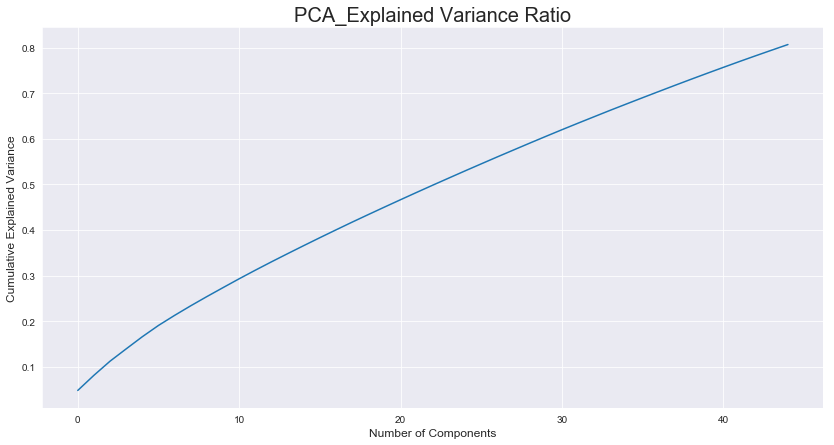

In [104]:
# PLotting the explained variance 
plt.figure(figsize= (14, 7))
sns.lineplot(data=np.cumsum(pca3.explained_variance_ratio_))
plt.xlabel("Number of Components", fontsize = 12)
plt.ylabel("Cumulative Explained Variance", fontsize = 12)
plt.title("PCA_Explained Variance Ratio", fontsize = 20);

From the plot above we can now see that we have captured about 80% of the variance of the original data, now we will go ahead and store this into a new dataframe in order to visualize using t-SNE. 

In [105]:
# Storing data from PCA into a dataframe
pca_columns = ["pc_1", "pc_2", "pc_3", "pc_4", "pc_5", "pc_6", "pc_7",
              "pc_8", "pc_9", "pc_10", "pc_11", "pc_12", "pc_13", "pc_14", "pc_15",
              "pc_16", "pc_17", "pc_18", "pc_19", "pc_20", "pc_21", "pc_22", "pc_23",
               "pc_24", "pc_25", "pc_26", "pc_27", "pc_28", "pc_29", "pc_30", "pc_31",
               "pc_32", "pc_33", "pc_34", "pc_35", "pc_36", "pc_37", "pc_38", "pc_39",
               "pc_40", "pc_41", "pc_42", "pc_43", "pc_44", "pc_45"]

pca_df = pd.DataFrame(data = pca_set2, columns = pca_columns)
pca_df

,pc_1,pc_2,pc_3,pc_4,pc_5,pc_6,pc_7,pc_8,pc_9,pc_10,pc_11,pc_12,pc_13,pc_14,pc_15,pc_16,pc_17,pc_18,pc_19,pc_20,pc_21,pc_22,pc_23,pc_24,pc_25,pc_26,pc_27,pc_28,pc_29,pc_30,pc_31,pc_32,pc_33,pc_34,pc_35,pc_36,pc_37,pc_38,pc_39,pc_40,pc_41,pc_42,pc_43,pc_44,pc_45
0,0.986088,0.160946,-0.455498,0.017498,0.178302,0.719644,-1.409393,0.251360,0.768290,-0.743392,0.376744,-0.110375,0.166503,-0.149559,-0.160325,-0.628921,0.884741,0.653456,-0.696790,0.307560,-0.159469,-0.157919,-0.351414,-0.120236,-0.176532,0.985270,0.392583,-0.359480,-0.048977,0.163702,-0.035157,-0.238973,-0.369913,-0.913731,0.382690,-0.107526,0.317139,-0.804162,-0.266340,0.496251,-0.203158,0.473192,-0.512921,-1.778744,1.152897
1,1.525644,0.386408,-0.339797,-1.138337,-0.195974,3.538144,-0.558692,-2.856342,1.012143,3.604236,4.071488,-1.834142,-3.268146,0.425624,0.730114,1.714158,-0.331494,-1.291177,5.734234,-5.766601,-2.220889,-1.315702,-0.470278,-2.435328,-0.810725,2.167392,-3.670461,3.593931,-4.485379,0.562809,-0.171859,5.082498,0.735470,-2.567104,1.277261,-3.815156,1.870760,-2.434042,1.084590,-0.392778,3.619910,0.213557,-0.911973,-1.385890,-2.017672
2,1.840120,0.074307,0.461977,-2.502748,0.427544,-0.602516,1.751137,-1.322033,-0.545393,2.038045,-2.004768,2.298630,-1.638765,1.735307,-1.115826,-0.600374,1.612514,-0.700956,-0.722690,0.763813,0.565360,0.216536,-0.390876,2.308225,0.275364,0.495723,0.293306,-0.746373,-0.280896,1.916457,0.062434,2.022370,0.949540,2.681415,-0.057541,-1.326219,1.297867,0.070548,2.367880,2.047715,0.225963,-0.758399,1.476993,0.172023,-0.622566
3,1.491474,0.270838,0.630625,-1.010281,0.144182,2.118032,-3.650091,0.467441,-0.077206,-1.512007,-3.400233,0.424986,-0.982362,1.116233,4.435641,0.950441,-1.029459,-0.803936,1.430575,3.887488,-1.118763,4.982224,2.347962,-2.191665,-2.734995,2.970762,1.822441,2.933080,-0.962234,9.169429,-4.397334,-4.564996,-5.121432,-0.255409,2.746626,1.136898,-0.484890,-0.963428,-0.344137,-0.053796,2.530066,-0.929203,-0.243619,-1.377974,-0.218992
4,1.255555,-0.260752,-1.031948,1.163003,1.100386,-0.684151,-1.819524,0.289468,-0.498786,-0.274779,-0.740012,0.810272,-1.355829,-0.752040,-0.331838,-0.968665,0.440346,1.488678,0.251191,-0.515594,-0.177689,-0.120668,0.173522,-2.139476,1.670267,0.159403,-0.572664,-1.590446,1.517333,0.486459,-0.252495,1.484533,0.082404,0.801630,0.940229,1.045718,-0.079314,0.373890,0.197767,-0.580192,0.140332,0.550962,-0.259464,0.070773,-0.714143
5,-0.855378,-0.255610,-1.236571,1.096939,1.499423,-0.430662,0.478340,-0.014820,-0.577987,-0.476073,0.239368,-0.617792,0.291699,-0.541958,0.143136,0.079718,0.868825,0.424397,-0.176336,-0.588323,-0.526732,0.344718,-1.044762,0.336680,0.556740,0.196254,0.492543,0.582338,-0.149455,-0.026329,-0.666334,-0.452964,0.021400,-0.158284,0.068323,0.693954,0.528908,-0.189014,-0.095877,0.521869,-0.223619,-0.886427,-0.115385,-0.595967,0.106696
6,-1.138898,-0.189944,-0.495022,-0.202435,0.850048,-1.352276,-0.557795,0.348960,-0.839298,0.850839,0.204526,0.297633,-0.841949,-0.861614,-1.020562,0.526936,-0.638661,0.583815,0.121590,-0.408415,0.106212,0.416492,0.186045,0.218942,0.560791,-0.066722,-0.005577,0.180337,0.259126,0.133859,0.023653,-0.705169,0.197954,-0.413149,0.004139,1.254689,-1.478215,-0.555089,0.669771,0.617405,0.382080,0.294462,1.089882,0.422304,0.333357
7,0.832041,-0.008912,0.192454,-1.790317,0.076656,-1.338333,2.352491,-1.273007,-0.606940,-0.442664,0.893289,0.583068,-1.025672,-0.915810,1.079295,-0.311690,-0.227473,0.506720,0.150017,1.082591,0.146590,-0.407880,1.260298,-0.763641,-0.015249,-0.303612,1.115072,-0.202120,-1.031140,0.164128,0.067121,1.183711,0.368874,0.596432,-0.113421,-0.151157,0.257778,0.425299,0.083408,-0.774732,-0.799503,0.589241,0.167221,1.453154,-0.275647
8,-1.981021,-0.223306,0.414802,0.727848,-0.988866,-0.752132,0.165072,-0.050694,0.877444,1.446610,0.282807,0.269368,-0.211705,-0.297659,-0.924848,-0.061460,0.017157,-0.251064,-0.960348,-0.405317,-0.184023,-0.420756,0.941870,-0.795928,0.312720,0.484916,1.855657,0.631412,1.047172,-0.385197,0.399975,-0.013158

In [106]:
final_pca = final_strain.copy()
final_pca.head()

,Strain,hybrid_Type,indica_Type,sativa_Type,Aroused_effect,Creative_effect,Dry_effect,Energetic_effect,Euphoric_effect,Focused_effect,Giggly_effect,Happy_effect,Hungry_effect,Mouth_effect,Relaxed_effect,Sleepy_effect,Talkative_effect,Tingly_effect,Uplifted_effect,Ammonia_flavor,Apple_flavor,Apricot_flavor,Berry_flavor,Blue_flavor,Blueberry_flavor,Butter_flavor,Cheese_flavor,Chemical_flavor,Chestnut_flavor,Citrus_flavor,Coffee_flavor,Diesel_flavor,Earthy_flavor,Flowery_flavor,Fruit_flavor,Grape_flavor,Grapefruit_flavor,Honey_flavor,Lavender_flavor,Lemon_flavor,Lime_flavor,Mango_flavor,Menthol_flavor,Mint_flavor,Minty_flavor,None_flavor,Nutty_flavor,Orange_flavor,Peach_flavor,Pear_flavor,Pepper_flavor,Pine_flavor,Pineapple_flavor,Plum_flavor,Pungent_flavor,Rose_flavor,Sage_flavor,Skunk_flavor,Spicy/Herbal_flavor,Strawberry_flavor,Sweet_flavor,Tar_flavor,Tea_flavor,Tobacco_flavor,Tree_flavor,Tropical_flavor,Vanilla_flavor,Violet_flavor,Woody_flavor,x,y
0,100-Og,1,0,0,0,1,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,5.010251,32.846371
1,98-White-Widow,1,0,0,1,1,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,-13.254560,21.994934
2,1024,0,0,1,0,1,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,17.069492,79.029778
3,13-Dawgs,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,31.350019,-16.986027
4,24K-Gold,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,11.137016,20.761280


In [107]:
# Dropping inicial t-SNE embeddings
final_pca.drop(columns=["x", "y"], inplace = True)
final_pca.head()

,Strain,hybrid_Type,indica_Type,sativa_Type,Aroused_effect,Creative_effect,Dry_effect,Energetic_effect,Euphoric_effect,Focused_effect,Giggly_effect,Happy_effect,Hungry_effect,Mouth_effect,Relaxed_effect,Sleepy_effect,Talkative_effect,Tingly_effect,Uplifted_effect,Ammonia_flavor,Apple_flavor,Apricot_flavor,Berry_flavor,Blue_flavor,Blueberry_flavor,Butter_flavor,Cheese_flavor,Chemical_flavor,Chestnut_flavor,Citrus_flavor,Coffee_flavor,Diesel_flavor,Earthy_flavor,Flowery_flavor,Fruit_flavor,Grape_flavor,Grapefruit_flavor,Honey_flavor,Lavender_flavor,Lemon_flavor,Lime_flavor,Mango_flavor,Menthol_flavor,Mint_flavor,Minty_flavor,None_flavor,Nutty_flavor,Orange_flavor,Peach_flavor,Pear_flavor,Pepper_flavor,Pine_flavor,Pineapple_flavor,Plum_flavor,Pungent_flavor,Rose_flavor,Sage_flavor,Skunk_flavor,Spicy/Herbal_flavor,Strawberry_flavor,Sweet_flavor,Tar_flavor,Tea_flavor,Tobacco_flavor,Tree_flavor,Tropical_flavor,Vanilla_flavor,Violet_flavor,Woody_flavor
0,100-Og,1,0,0,0,1,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
1,98-White-Widow,1,0,0,1,1,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,1024,0,0,1,0,1,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1
3,13-Dawgs,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,24K-Gold,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [108]:
# Applying t-SNE in order to visualize and compare new recommendations later on
pca_embedded = tsne.fit_transform(pca_set2)
pca_embedded.shape

(2263, 2)

In [109]:
# Placing new t-SNE embeddings into the dataframe
final_pca["X"] = pca_embedded[:, 0]
final_pca["Y"] = pca_embedded[:, 1]

In [110]:
final_pca.head()

,Strain,hybrid_Type,indica_Type,sativa_Type,Aroused_effect,Creative_effect,Dry_effect,Energetic_effect,Euphoric_effect,Focused_effect,Giggly_effect,Happy_effect,Hungry_effect,Mouth_effect,Relaxed_effect,Sleepy_effect,Talkative_effect,Tingly_effect,Uplifted_effect,Ammonia_flavor,Apple_flavor,Apricot_flavor,Berry_flavor,Blue_flavor,Blueberry_flavor,Butter_flavor,Cheese_flavor,Chemical_flavor,Chestnut_flavor,Citrus_flavor,Coffee_flavor,Diesel_flavor,Earthy_flavor,Flowery_flavor,Fruit_flavor,Grape_flavor,Grapefruit_flavor,Honey_flavor,Lavender_flavor,Lemon_flavor,Lime_flavor,Mango_flavor,Menthol_flavor,Mint_flavor,Minty_flavor,None_flavor,Nutty_flavor,Orange_flavor,Peach_flavor,Pear_flavor,Pepper_flavor,Pine_flavor,Pineapple_flavor,Plum_flavor,Pungent_flavor,Rose_flavor,Sage_flavor,Skunk_flavor,Spicy/Herbal_flavor,Strawberry_flavor,Sweet_flavor,Tar_flavor,Tea_flavor,Tobacco_flavor,Tree_flavor,Tropical_flavor,Vanilla_flavor,Violet_flavor,Woody_flavor,X,Y
0,100-Og,1,0,0,0,1,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,-36.671612,13.040949
1,98-White-Widow,1,0,0,1,1,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,5.078846,-63.517620
2,1024,0,0,1,0,1,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,61.555759,-30.816805
3,13-Dawgs,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,70.061386,-2.382266
4,24K-Gold,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3.611789,68.446060


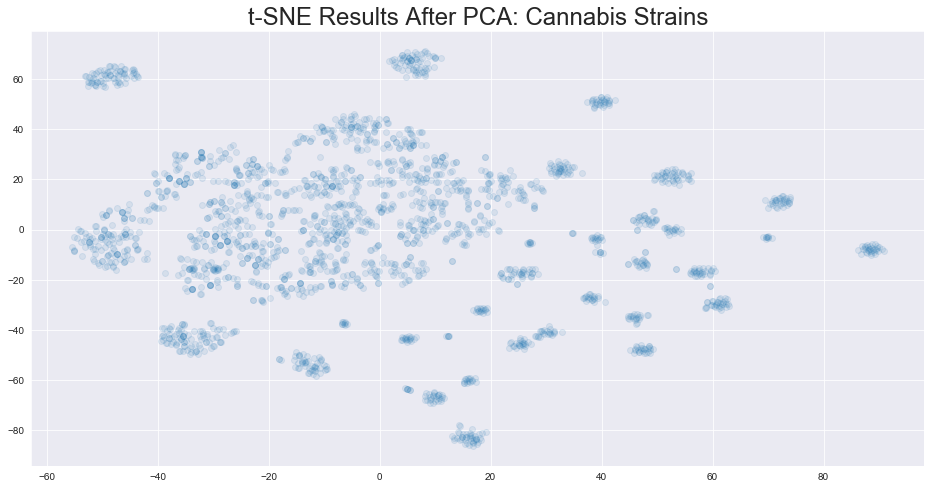

In [111]:
# PLotting the new 2d space of my data
fig_size = (16, 8)
fig, ax = plt.subplots(figsize = fig_size)
ax.scatter(final_pca.X, final_pca.Y, alpha = 0.1)
ax.set_title("t-SNE Results After PCA: Cannabis Strains", fontsize = 24)
plt.show();

Interesting, this has a very different structure compared to our initial t-SNE with the raw data. It does not seem to separate the types of strains as well as it did before PCA, this is due to the loss of information from reducing the dimensionality of our dataset. I will use cosine similarity on the PCA data and see if any new insights are gained through new recommendations. 

In [112]:
co_sim_2 = cosine_similarity(pca_df, pca_df)

In [113]:
co_sim_2.shape

(2263, 2263)

In [114]:
OG_recommends_2 = get_recommendations("100-Og", cosine_sim=co_sim_2)

[(2137, 0.7325009502172508), (1239, 0.6566484411523493), (975, 0.6523747666207362), (2045, 0.6507794076084256), (96, 0.6349151331962123), (78, 0.6334949719776387), (1284, 0.6241045333880861), (1035, 0.6036976620426014), (2160, 0.5749150540755845), (628, 0.5677363919120995)]


In [115]:
OG_recommends_2

2137              Valentine-X
1239                Lifesaver
975     Hawaiian-Thunder-Fuck
2045                Thai-Girl
96             American-Dream
78           Alien-Rock-Candy
1284              Majestic-12
1035                Ice-Wreck
2160                    Waldo
628               Desert-Star
Name: Strain, dtype: object

In [116]:
OG_recomends

78     Alien-Rock-Candy
88         Aloha-Limone
96       American-Dream
121             Area-51
283       Blue-Hawaiian
409       Cactus-Cooler
432       Captains-Cake
521       Cinderella-99
680         Dream-Queen
742        Eugene-Cream
Name: Strain, dtype: object

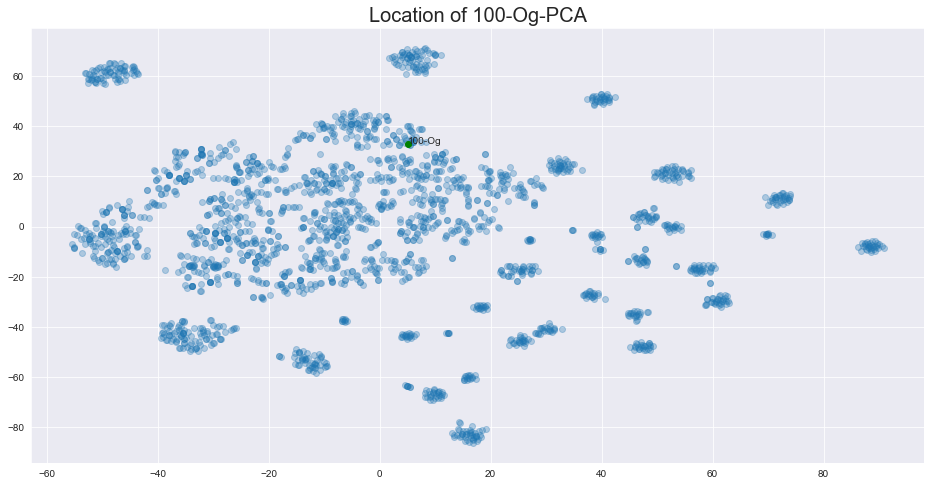

In [117]:
plot_by_title_pattern("100-Og", figsize = (16, 8), bg_alpha= 0.3, text= True, 
                      emb_2d = pca_embedded)
plt.title("Location of 100-Og-PCA", fontsize = 20);

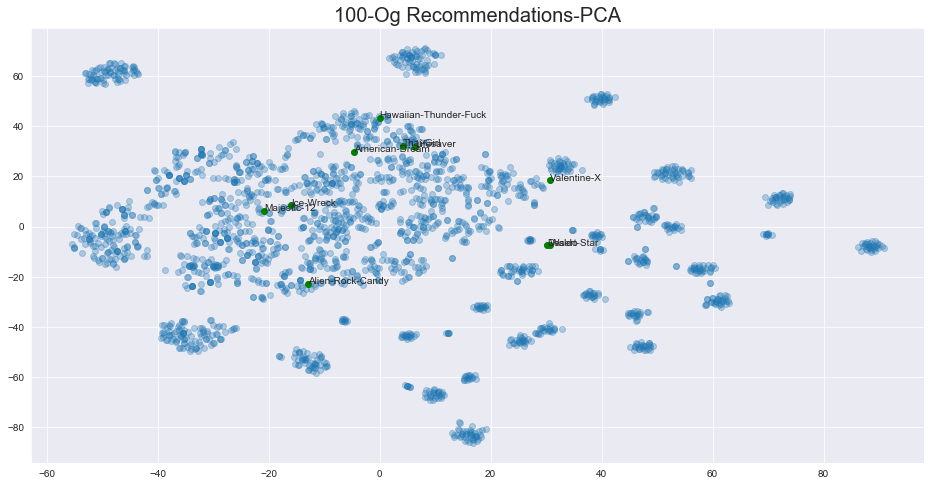

In [118]:
plot_with_annotations(OG_recommends_2.index, bg_alpha = 0.3, text = True,
                     figsize = (16, 8), emb_2d = pca_embedded)
plt.title("100-Og Recommendations-PCA", fontsize= 20);

Observing the two plots above we can see that there are only three strains that a very close to the 100-Og strain, the other recommendations are actually a bit further than our original recommendations and before performing PCA. 

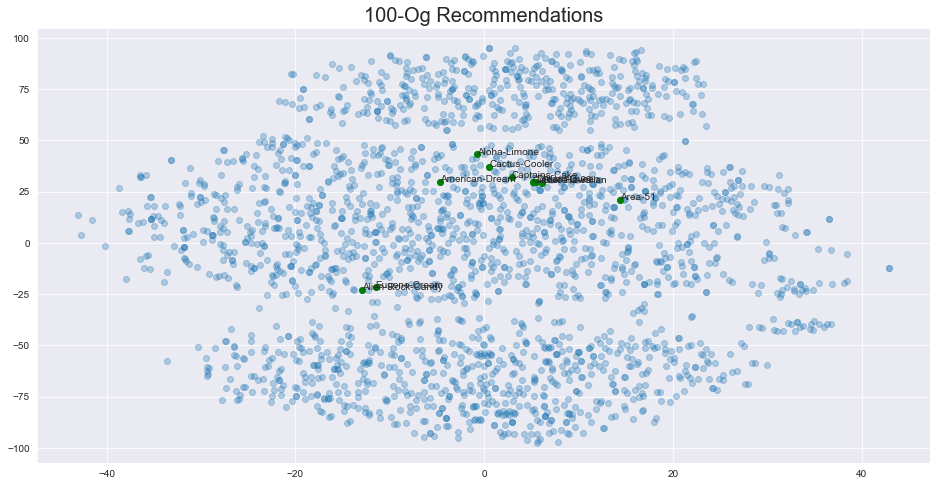

In [119]:
# Original recommendations without PCA
plot_with_annotations(OG_recomends.index, bg_alpha = 0.3, text = True,
                     figsize = (16, 8))
plt.title("100-Og Recommendations", fontsize= 20);

In [120]:
print("*******************************************************")
print(raw_df.iloc[0])
print("*******************************************************")
print(raw_df.iloc[1239])
print("*******************************************************")
print(raw_df.iloc[2045])
print("*******************************************************")
print(raw_df.iloc[356])
print("*******************************************************")
print(raw_df.iloc[1035])
print("*******************************************************")
print(raw_df.iloc[2137])
print("*******************************************************")
print(raw_df.iloc[1262])

*******************************************************
Strain                                         100-Og
Type                                           hybrid
Rating                                              4
Effects    Creative,Energetic,Tingly,Euphoric,Relaxed
Flavor                            Earthy,Sweet,Citrus
Name: 0, dtype: object
*******************************************************
Strain                                      Lifesaver
Type                                           hybrid
Rating                                            4.5
Effects    Relaxed,Euphoric,Energetic,Uplifted,Tingly
Flavor                             Citrus,Sweet,Berry
Name: 1240, dtype: object
*******************************************************
Strain                                     Thai-Girl
Type                                          hybrid
Rating                                             4
Effects    Euphoric,Relaxed,Energetic,Focused,Tingly
Flavor                         

From comparing the effects and flavors of the recommended strains, Thai-Girl and Lifesaver do share the "tingly", "relaxed", "energetic", and "euphoric" effects and the "sweet" and "citrus" flavors with 100-Og. The other recommendations do include the "creative" effect but on the flavor side they are not that similiar. Another thing to notice is that one of the recommendations has only one effect and one flavor reported, which gives doubt about how good these recommendations are.  

In [121]:
# New recommendations for a sativa strain
sup_sil_haze_recommends_2 = get_recommendations("Super-Silver-Haze", 
                                                cosine_sim= co_sim_2)

[(1974, 1.0), (524, 0.8637728938024226), (904, 0.8637728938024226), (1956, 0.8275223827195064), (170, 0.8076332707394551), (900, 0.8076332707394551), (1041, 0.8076332707394551), (169, 0.7936056722909848), (2180, 0.7545125632789941), (25, 0.7463668844881314)]


In [122]:
sup_sil_haze_recommends_2

1974    Super-Silver-Haze
524                 Cinex
904           Green-Crack
1956              Sunburn
170             Bay-Dream
900           White-Shark
1041      Incredible-Hulk
169                Bay-11
2180        White-Buffalo
25          Acapulco-Gold
Name: Strain, dtype: object

In [123]:
sup_sil_haze_recommends

1974    Super-Silver-Haze
25          Acapulco-Gold
60            Alaskan-Ice
169                Bay-11
170             Bay-Dream
283         Blue-Hawaiian
521         Cinderella-99
524                 Cinex
680           Dream-Queen
692        Dutch-Hawaiian
Name: Strain, dtype: object

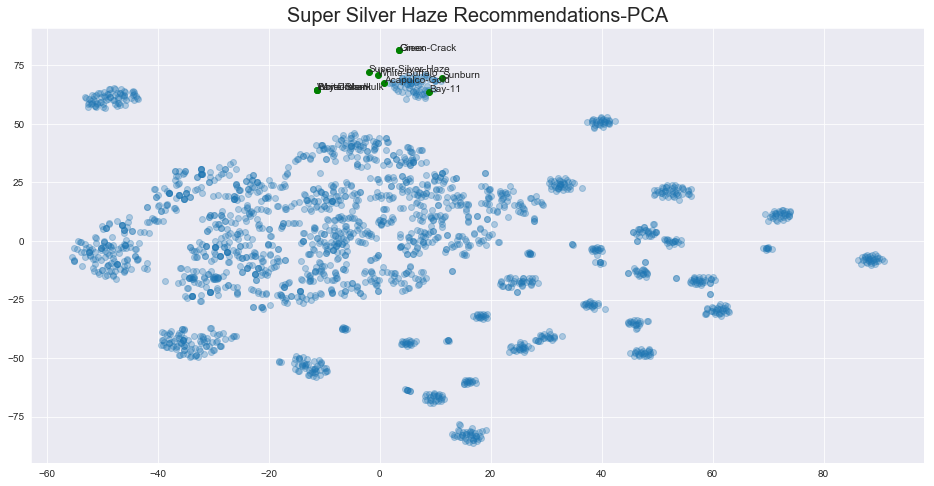

In [124]:
plot_with_annotations(sup_sil_haze_recommends_2.index, bg_alpha = 0.3, text = True,
                     figsize = (16, 8), emb_2d = pca_embedded)
plt.title("Super Silver Haze Recommendations-PCA", fontsize= 20);

Not one of the recommendations falls into the clusters created by perfoming t-SNE on the PCA data. This raises even more doubt about whether or not PCA was a good idea to do on this type of data. It seems as if we have lost too much information from the data, eventhough we have captured about 80% of its variance.

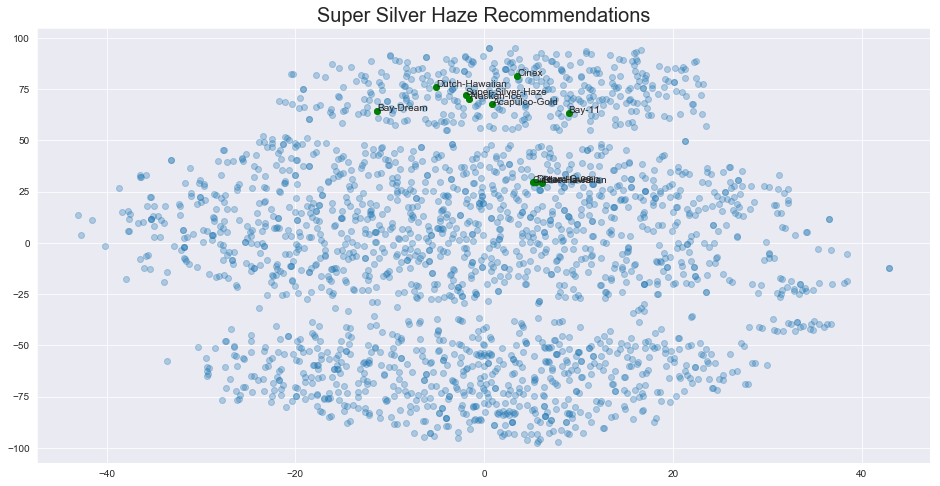

In [125]:
# Original sativa recommendations
plot_with_annotations(sup_sil_haze_recommends.index, bg_alpha = 0.3, text = True,
                     figsize = (16, 8))
plt.title("Super Silver Haze Recommendations", fontsize= 20);

In [126]:
print("*******************************************************")
print(raw_df.iloc[1974])
print("*******************************************************")
print(raw_df.iloc[904])
print("*******************************************************")
print(raw_df.iloc[900])
print("*******************************************************")
print(raw_df.iloc[1041])
print("*******************************************************")
print(raw_df.iloc[1956])
print("*******************************************************")
print(raw_df.iloc[1218])


*******************************************************
Strain                             Super-Silver-Haze
Type                                          sativa
Rating                                           4.4
Effects    Happy,Uplifted,Energetic,Euphoric,Relaxed
Flavor                           Citrus,Earthy,Sweet
Name: 1975, dtype: object
*******************************************************
Strain                                   Green-Crack
Type                                          sativa
Rating                                           4.3
Effects    Energetic,Happy,Uplifted,Focused,Euphoric
Flavor                           Earthy,Citrus,Sweet
Name: 905, dtype: object
*******************************************************
Strain                                 White-Shark
Type                                        sativa
Rating                                         4.2
Effects    Happy,Uplifted,Relaxed,Focused,Euphoric
Flavor                         Sweet,Citrus,Ear

Eventhough these recommendations do make sense because of the way they share effects and flavors, the original recommendations included strains from the hybrid type group. One of the great things about this recommendation system was that it was able to give a bit of versatility and variety by suggesting to the user to try a different type of strain then what they are used to. We are not seeing that here with the dimensionally reduced data. 

In [127]:
# New recommendation for indica strain
bubba_recommends_2 = get_recommendations("Bubba-Kush", cosine_sim= co_sim_2)

[(137, 1.0000000000000004), (372, 1.0000000000000004), (501, 1.0000000000000004), (506, 1.0000000000000004), (799, 0.9002606295490493), (2186, 0.9002606295490493), (2079, 0.8696417941412166), (1155, 0.8668805247553464), (1271, 0.8668805247553464), (1342, 0.8668805247553464)]


In [128]:
bubba_recommends_2

137     Aurora-Borealis
372          Bubba-Kush
501     Chocolate-Chunk
506      Chocolate-Kush
799                G-13
2186       White-Dragon
2079     Throwback-Kush
1155        Kosher-Kush
1271           Mk-Ultra
1342         Mercury-Og
Name: Strain, dtype: object

In [129]:
bubba_recommends

137    Aurora-Borealis
372         Bubba-Kush
501    Chocolate-Chunk
506     Chocolate-Kush
15      9-Pound-Hammer
37         Afghan-Kush
41             Afghani
47               Afgoo
69         Alien-Bubba
105         Anesthesia
Name: Strain, dtype: object

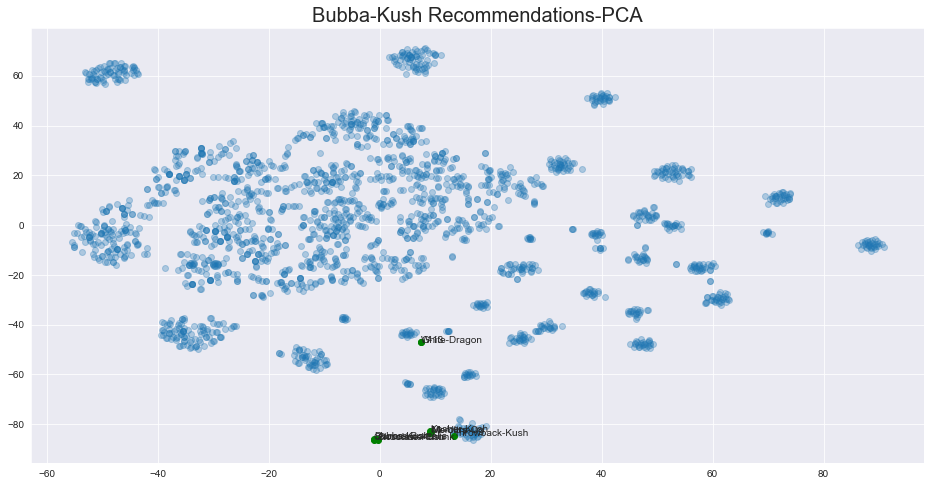

In [130]:
plot_with_annotations(bubba_recommends_2.index, bg_alpha = 0.3, text = True,
                     figsize = (16, 8), emb_2d = pca_embedded)
plt.title("Bubba-Kush Recommendations-PCA", fontsize= 20);

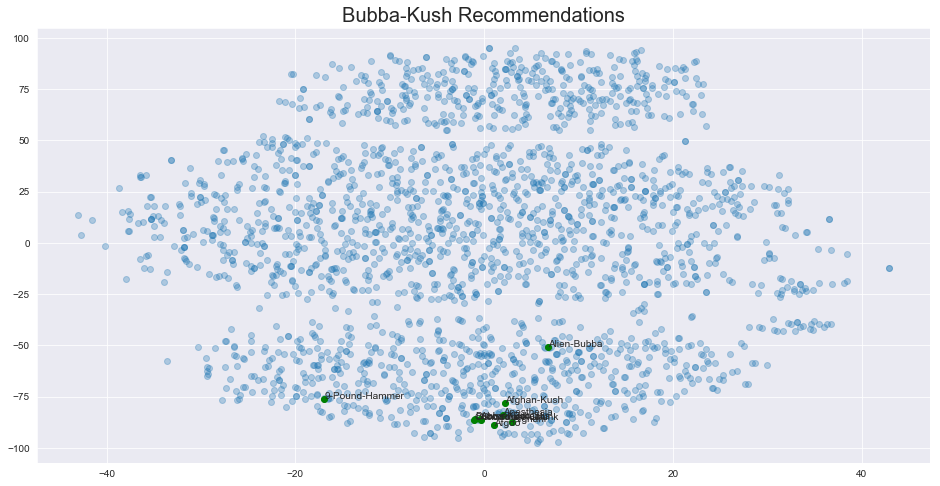

In [131]:
plot_with_annotations(bubba_recommends.index, bg_alpha = 0.3, text = True,
                     figsize = (16, 8))
plt.title("Bubba-Kush Recommendations", fontsize= 20);

In [132]:
print("*******************************************************")
print(raw_df.iloc[372])
print("*******************************************************")
print(raw_df.iloc[799])
print("*******************************************************")
print(raw_df.iloc[2186])
print("*******************************************************")
print(raw_df.iloc[1155])
print("*******************************************************")
print(raw_df.iloc[1271])
print("*******************************************************")
print(raw_df.iloc[2079])
print("*******************************************************")
print(raw_df.iloc[1384])

*******************************************************
Strain                               Bubba-Kush
Type                                     indica
Rating                                      4.3
Effects    Relaxed,Happy,Sleepy,Euphoric,Hungry
Flavor                       Earthy,Sweet,Woody
Name: 373, dtype: object
*******************************************************
Strain                                       G-13
Type                                       indica
Rating                                        4.4
Effects    Relaxed,Happy,Euphoric,Uplifted,Hungry
Flavor                         Earthy,Sweet,Woody
Name: 800, dtype: object
*******************************************************
Strain                               White-Dragon
Type                                       indica
Rating                                        4.2
Effects    Relaxed,Happy,Hungry,Euphoric,Uplifted
Flavor                         Earthy,Woody,Sweet
Name: 2187, dtype: object
****************

Again, these recommendations seem to make sense but the patterns are more evident with the original data before performing PCA. They are very close in the plot yet they do not all line up with the clusters that we have from the t-SNE plot. 

## Conclusions

I made various comparisons with the recommendations generated from the raw data and the data that went through PCA, although both recommendations seemed to make sense and the strains that were recommended were very similar to the input strain, it seemed to me that using the entire dataset was more useful and provided more variety in the types of strains that were recommended. 

We saw that in the original recommendations for the sativa type strain, the user was suggested to try a different type of strain other than a sativa. I feel like this would be a very important value of my recommendation system, which was not seen after performing dimension reduction. For now I will stick with the first version of the recommendation engine.

## Business Recommendations

 - In order to optimize this recommendation system, we must collect more user-based data with more ratings and the average of prices seen in different dispensaries. This will give us more that just categorical data to work with.
 
 - For now we should use the raw data set to model our recommendations, this data provided more variety in its suggestions which is a great feature to have. 


## Future Work

 - Use the current ratings reported and implement them into the current recommender.
 - Gather more data about pricing and new strains that have been created, as well as more user based content so that we can apply collabrative filtering into our recommendation system.
 - Use the current descriptions about the strains to gain further insight about what are the most important things to consider when trying a new strain. 
 - Use other dimensionality reduction techniques such as Autoencoders, to build different kinds of embeddings to possibly make better suggestions.